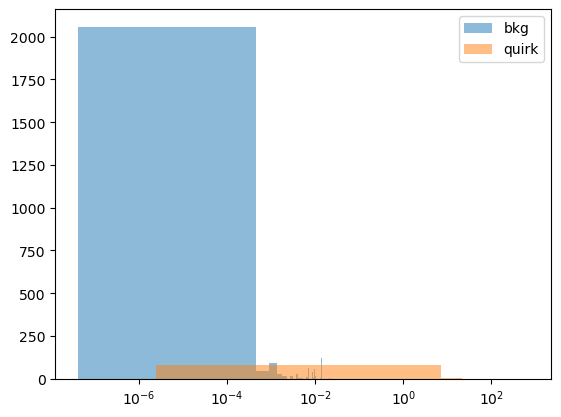

In [7]:
#Draw chi_square value


import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV files into dataframes
df_quirk = pd.read_csv('./output/track_quirk_2000.csv')
df_bkg = pd.read_csv('./output/track_bkg_2000.csv')

# Group the dataframe by 'particle_id' and keep only the first row for each group
#df_reduced_bkg_sel = df_bkg[df_bkg['chi_square_rz'] <= 10].groupby('particle_id').first().reset_index()
#df_reduced_quirk_sel = df_quirk[df_quirk['chi_square_rz'] <= 10].groupby('particle_id').first().reset_index()
df_reduced_bkg = df_bkg.groupby('particle_id').first().reset_index()
df_reduced_quirk = df_quirk.groupby('particle_id').first().reset_index()

# Plot the 'chi-square_rz' column of 'track_bkg.csv' on a log scale with label 'bkg'
plt.hist(df_reduced_bkg['chi_square_rz'], bins=100, alpha=0.5, label='bkg')
#plt.hist(df_reduced_bkg['chi_square_rz'], bins=100, alpha=0.5, label='bkg', density = True)
# Plot the 'chi-square_rz' column of 'track_quirk.csv' on a log scale with label 'quirk'
plt.hist(df_reduced_quirk['chi_square_rz'], bins=100, alpha=0.5, label='quirk')
#plt.hist(df_reduced_quirk['chi_square_rz'], bins=100, alpha=0.5, label='quirk', density = True)
# Add legend to the plot
plt.legend()
# Set x-axis to logarithmic scale
plt.xscale('log')
plt.show()

#plt.hist(df_reduced_bkg_sel['chi_square_rz'], bins=100, alpha=0.5, label='bkg', density = True)
## Plot the 'chi-square_rz' column of 'track_quirk.csv' on a log scale with label 'quirk'
#plt.hist(df_reduced_quirk_sel['chi_square_rz'], bins=100, alpha=0.5, label='quirk', density = True)
## Add legend to the plot
#plt.legend()
#plt.show()

In [34]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import math
import os

data = {'event_number': [], 'angle_radians': [], 'n_true_hits': [], 'truth_pt':[]}

df_quirk = pd.read_csv('./output/track_quirk_2000.csv')
reconstruct_data = df_quirk.drop_duplicates(subset=['particle_id'])
event_file_array = reconstruct_data['event_id'].to_numpy()

# 循环处理每个 event_number
for event_number in event_file_array:
    file_hit_name = f"../QuirkTracking/datasets/Lambda500/Quirk/event00000{event_number}-hits.csv"
    df = pd.read_csv(file_hit_name)
    df['r'] = (df['r']) / 51.4
    df['x'] = (df['r']) * np.cos(df['phi'])
    df['y'] = (df['r']) * np.sin(df['phi'])
    df['z'] = df['z'] / 100.

    # 读取CSV文件并计算角度
    file_particle_name = f"../QuirkTracking/datasets/Lambda500/Quirk/event00000{event_number}-particles.csv"
    dfp = pd.read_csv(file_particle_name)
    particle1 = dfp.iloc[0][['px', 'py', 'pz']]
    particle2 = dfp.iloc[1][['px', 'py', 'pz']]
    magnitude1 = np.linalg.norm(particle1)
    magnitude2 = np.linalg.norm(particle2)
    cosine_theta = np.dot(particle1, particle2) / (magnitude1 * magnitude2)
    angle_radians = math.acos(cosine_theta)
    angle_degrees = math.degrees(angle_radians)
    print(f"The angle between two particles in Event {event_number}: degree: {angle_degrees}, rad: {angle_radians}")

    # 获取reconstruct_data的数据
    df_reconstruct = df_quirk[df_quirk['event_id'] == event_number]
    
    # Get the n_true_hits from the corresponding track_quirk_2000.csv
    n_true_hits = df_reconstruct['n_true_hits'].values[0]
    truth_pt = df_reconstruct['pt'].values[0]

    # Append the data to the DataFrame
    data['n_true_hits'].append(n_true_hits)
    data['angle_radians'].append(angle_radians)
    data['event_number'].append(event_number)
    data['truth_pt'].append(truth_pt)

# Create a DataFrame from the collected data
result_df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
output_directory = './output'  # Change this to your desired directory
result_csv_path = os.path.join(output_directory, 'test.csv')
result_df.to_csv(result_csv_path, index=False)

print("Data saved to test.csv")


The angle between two particles in Event 2021: degree: 12.559743120724029, rad: 0.21920887066134195
The angle between two particles in Event 2027: degree: 131.6696434038038, rad: 2.29806880232321
The angle between two particles in Event 2051: degree: 25.16661360507537, rad: 0.4392402689857651
The angle between two particles in Event 2110: degree: 59.402653433618674, rad: 1.0367718868377607
The angle between two particles in Event 2110: degree: 59.402653433618674, rad: 1.0367718868377607
The angle between two particles in Event 2122: degree: 78.6571445770334, rad: 1.3728261530864354
The angle between two particles in Event 2146: degree: 90.01416375132908, rad: 1.5710435308900228
The angle between two particles in Event 2155: degree: 26.762566898533258, rad: 0.46709490866465253
The angle between two particles in Event 2191: degree: 22.58202129785754, rad: 0.3941306234030972
The angle between two particles in Event 2201: degree: 14.617365287852193, rad: 0.25512115223974946
The angle betwe

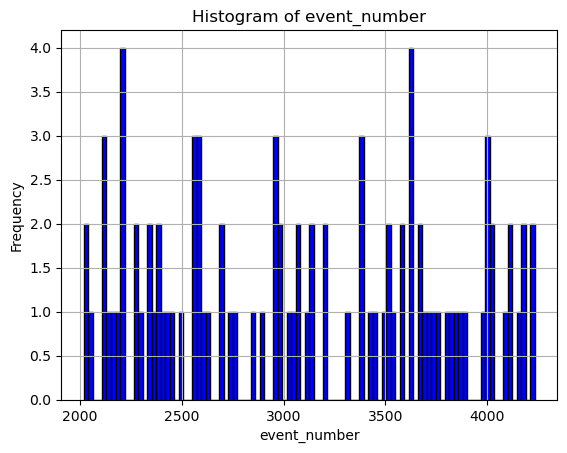

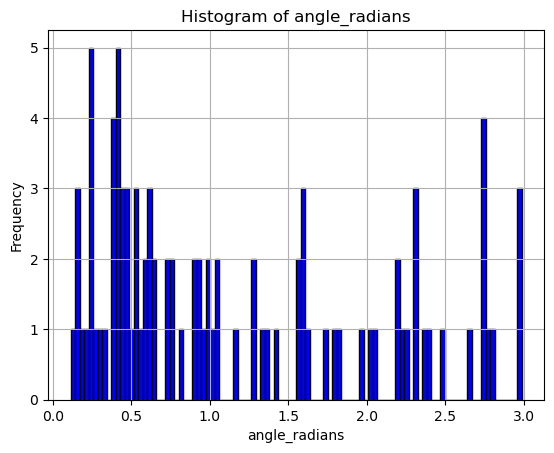

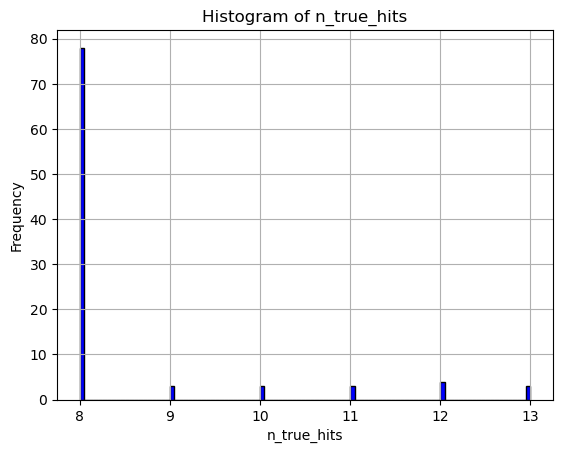

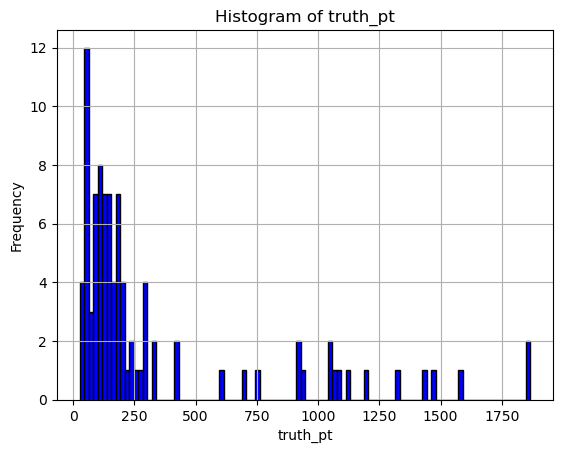

In [35]:
#Information of Bkg

import matplotlib.pyplot as plt
import pandas as pd

df_quirk = pd.read_csv('./output/test.csv')
reconstruct_data_reduce = df_quirk

for column_name in reconstruct_data_reduce.columns:
    column_data = reconstruct_data_reduce[column_name]
    
    plt.hist(column_data, bins=100, color='blue', edgecolor='black')
    #plt.xlim(0, 20)
    plt.xlabel(column_name)
    plt.ylabel('Frequency')
    plt.title(f'Histogram of {column_name}')
    
    plt.grid(True)
    
    plt.show()

The angle between two particles in Event 2021: degree: 12.559743120724029, rad: 0.21920887066134195


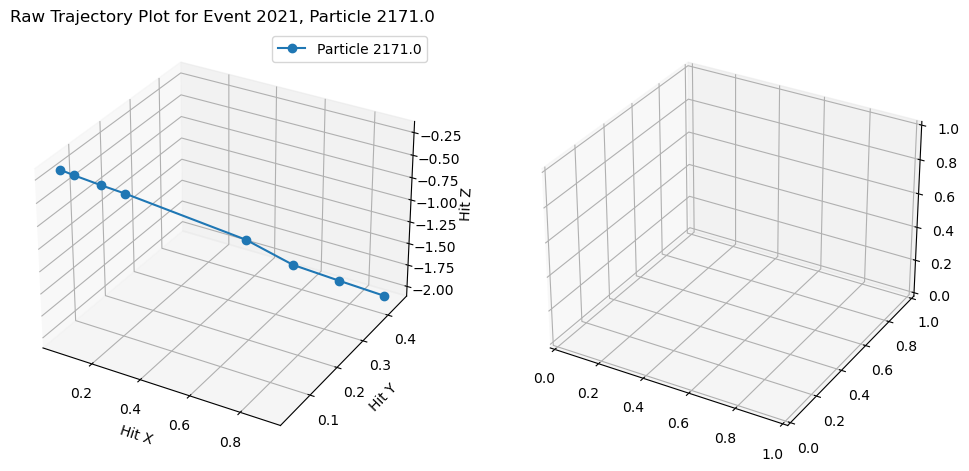

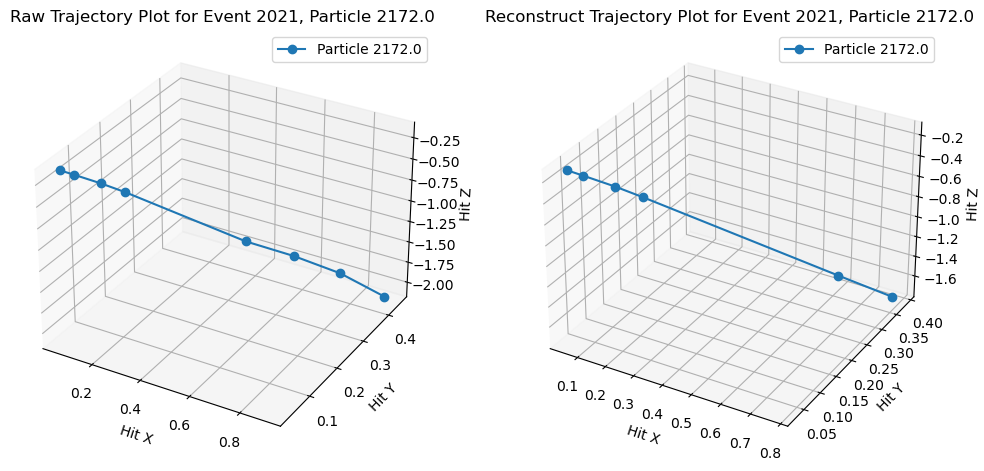

The angle between two particles in Event 2027: degree: 131.6696434038038, rad: 2.29806880232321


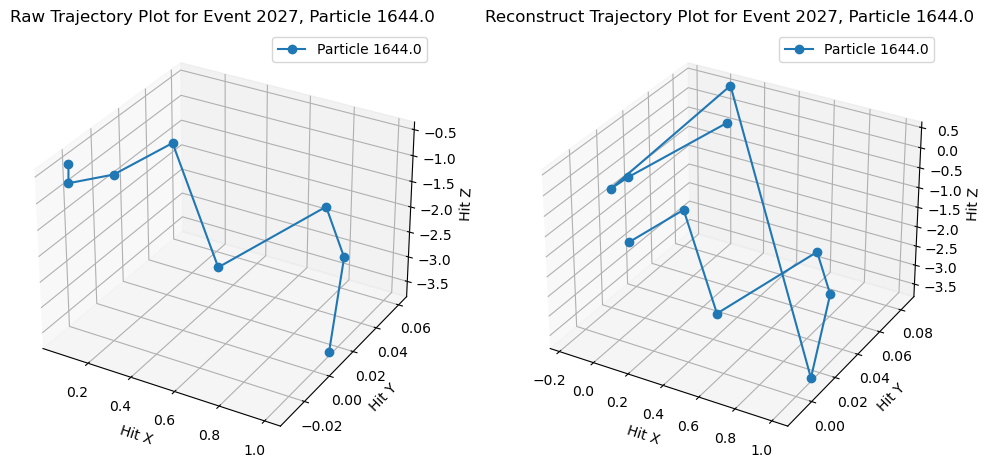

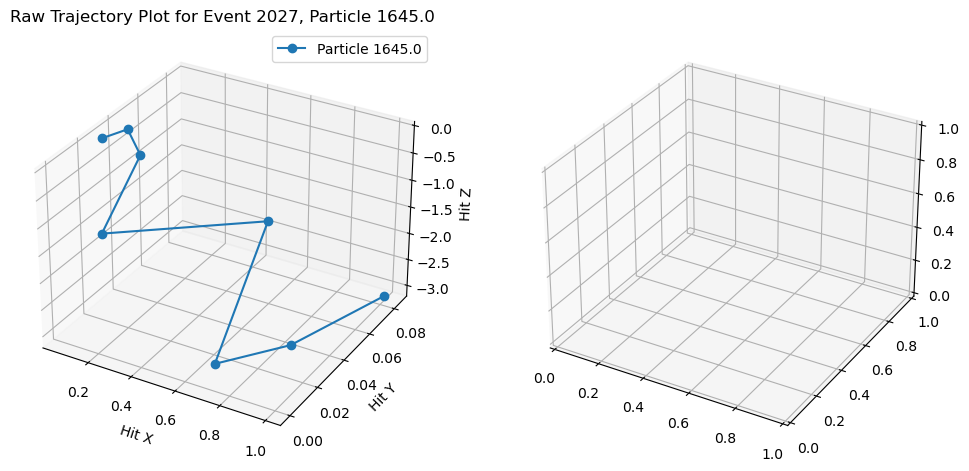

The angle between two particles in Event 2051: degree: 25.16661360507537, rad: 0.4392402689857651


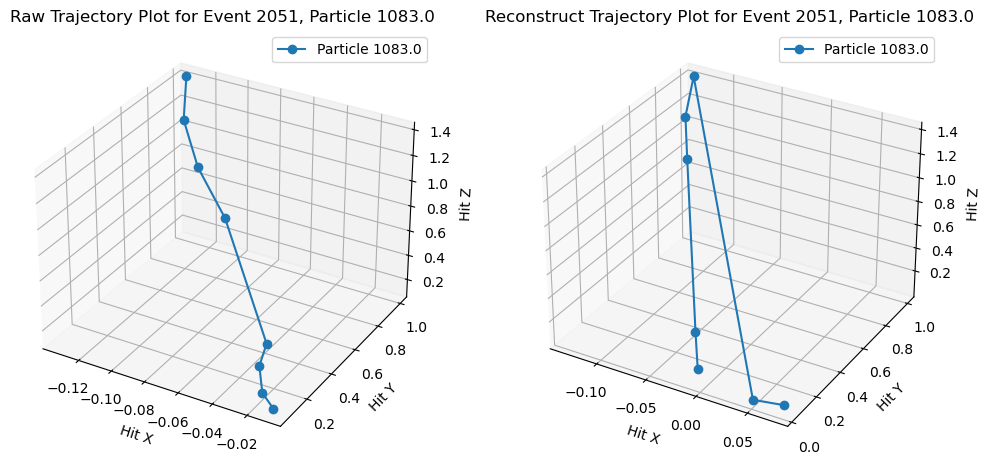

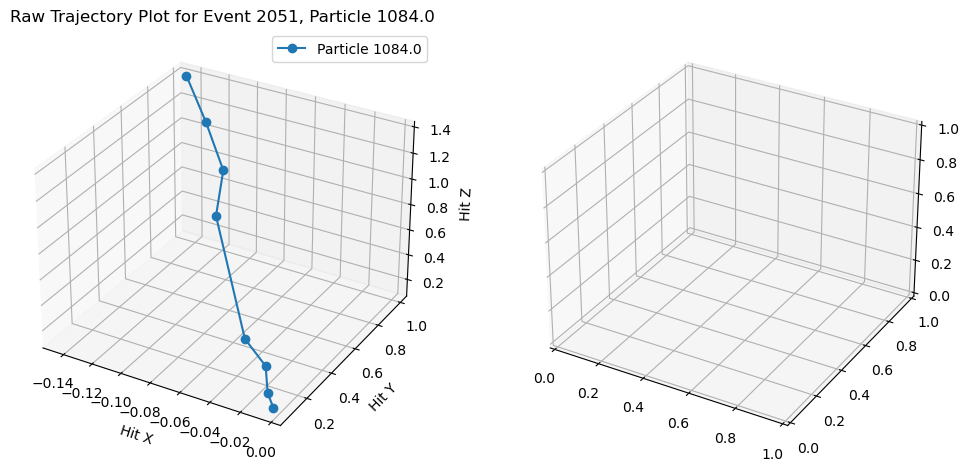

The angle between two particles in Event 2110: degree: 59.402653433618674, rad: 1.0367718868377607


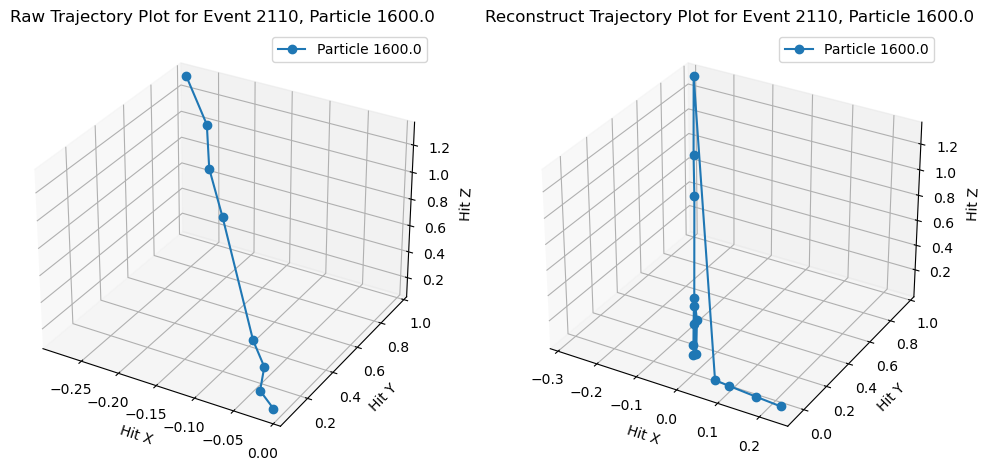

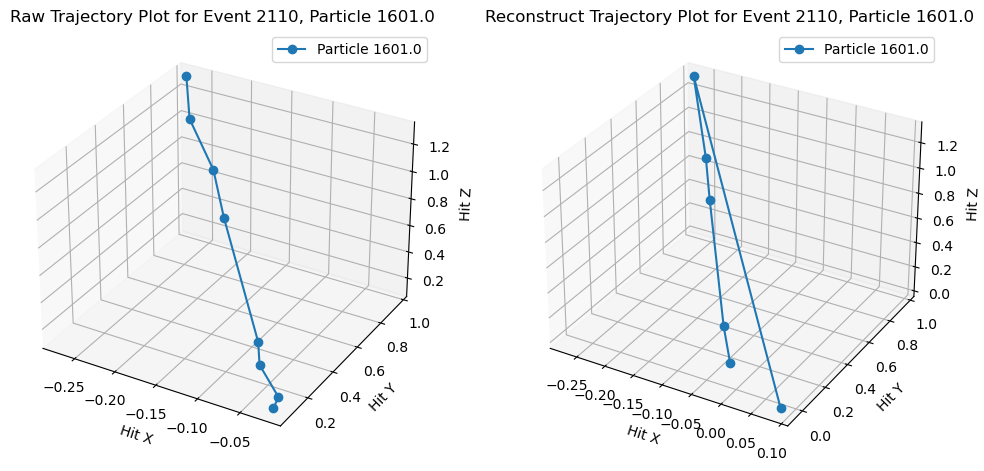

The angle between two particles in Event 2110: degree: 59.402653433618674, rad: 1.0367718868377607


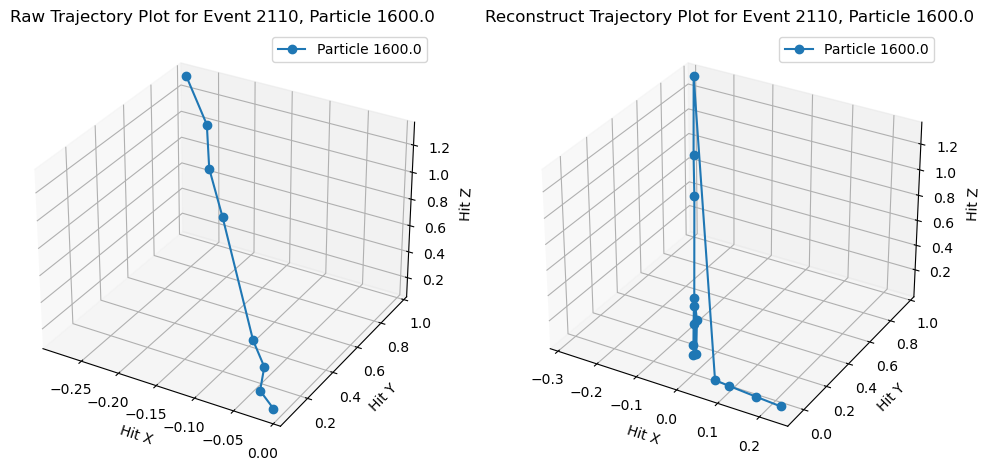

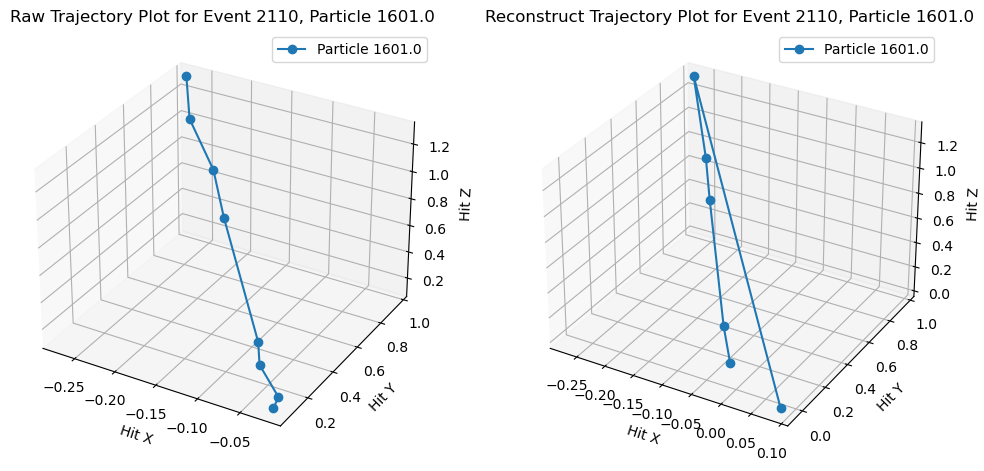

The angle between two particles in Event 2122: degree: 78.6571445770334, rad: 1.3728261530864354


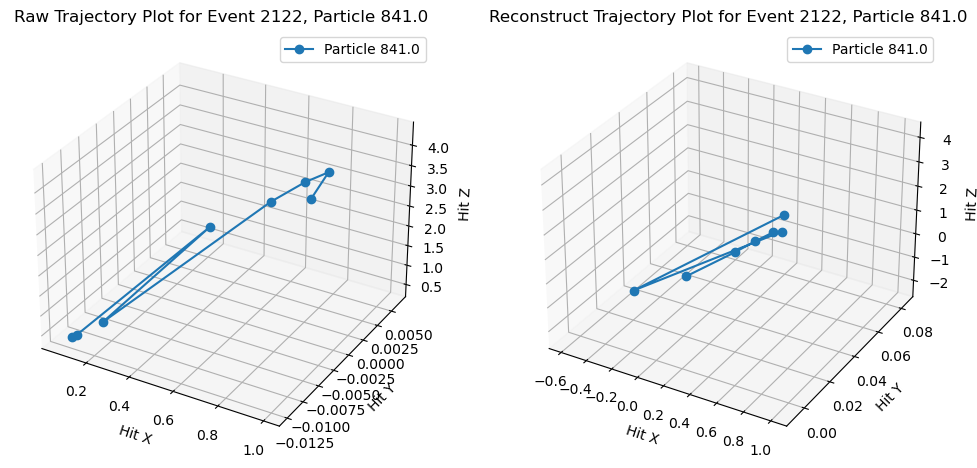

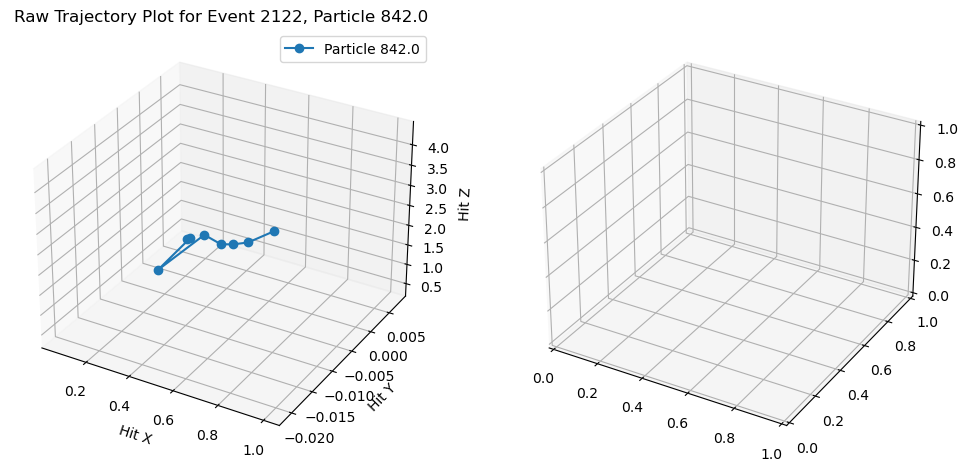

The angle between two particles in Event 2146: degree: 90.01416375132908, rad: 1.5710435308900228


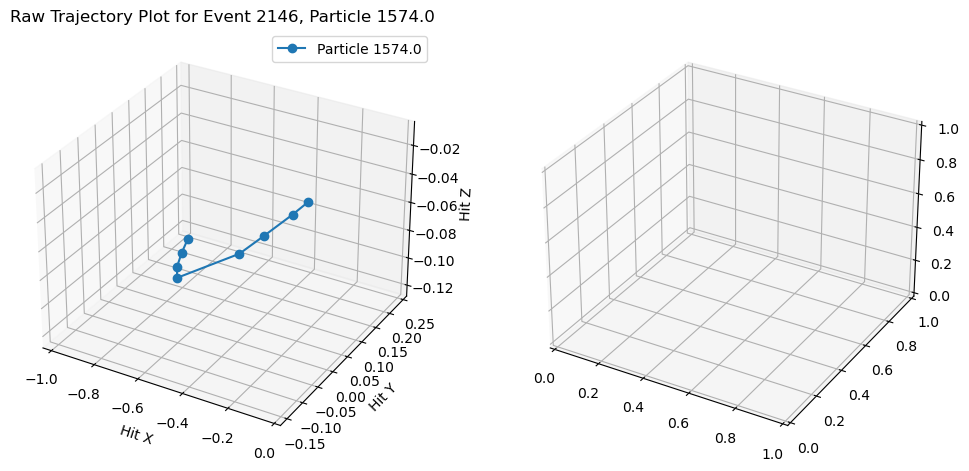

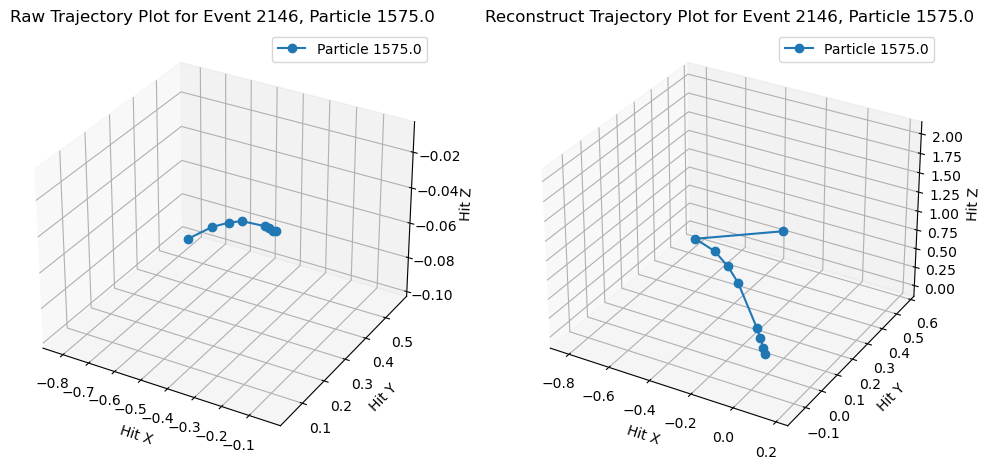

The angle between two particles in Event 2155: degree: 26.762566898533258, rad: 0.46709490866465253


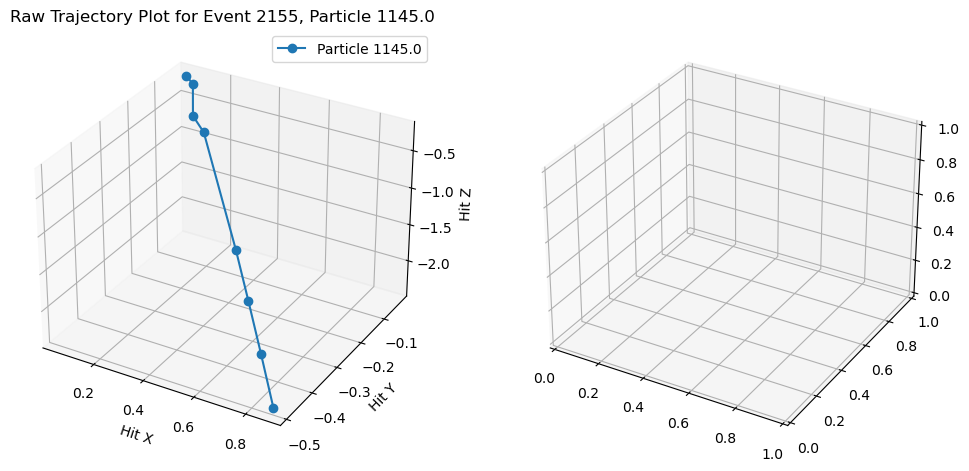

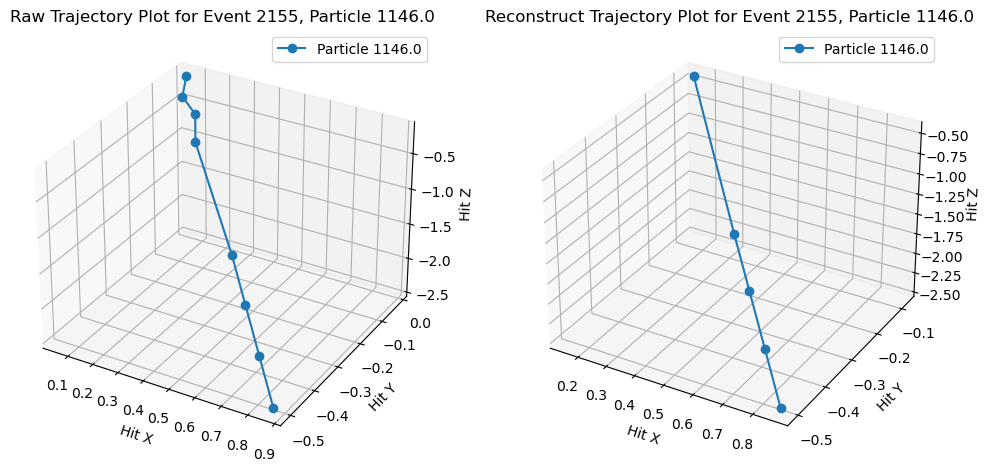

The angle between two particles in Event 2191: degree: 22.58202129785754, rad: 0.3941306234030972


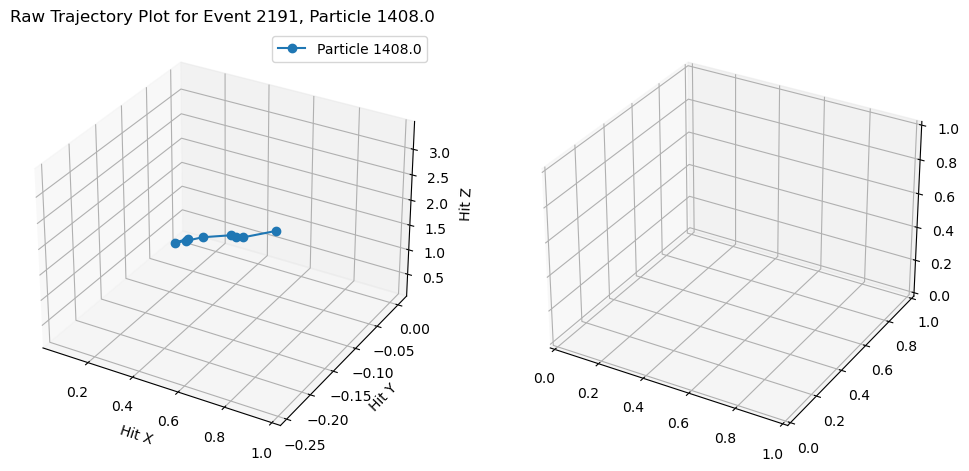

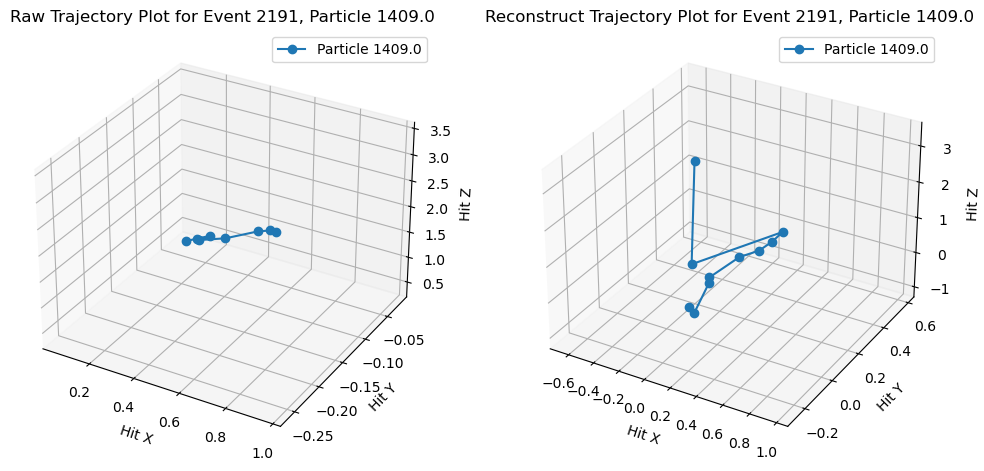

The angle between two particles in Event 2201: degree: 14.617365287852193, rad: 0.25512115223974946


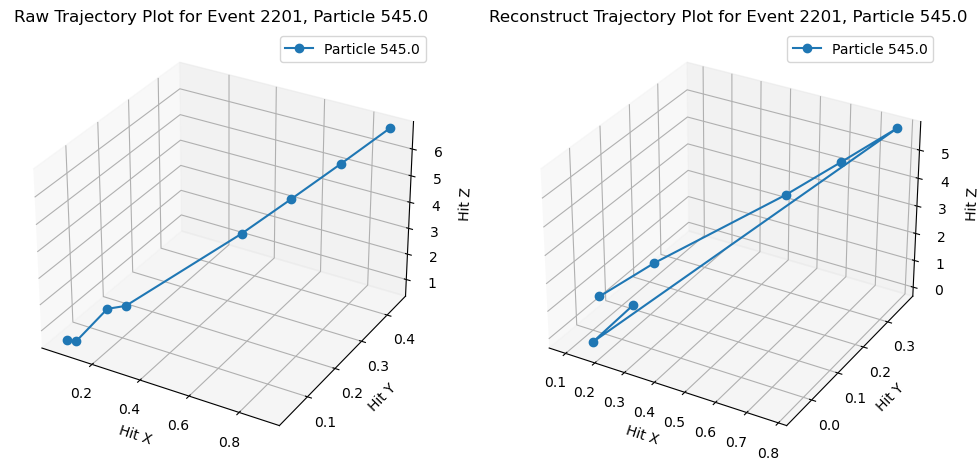

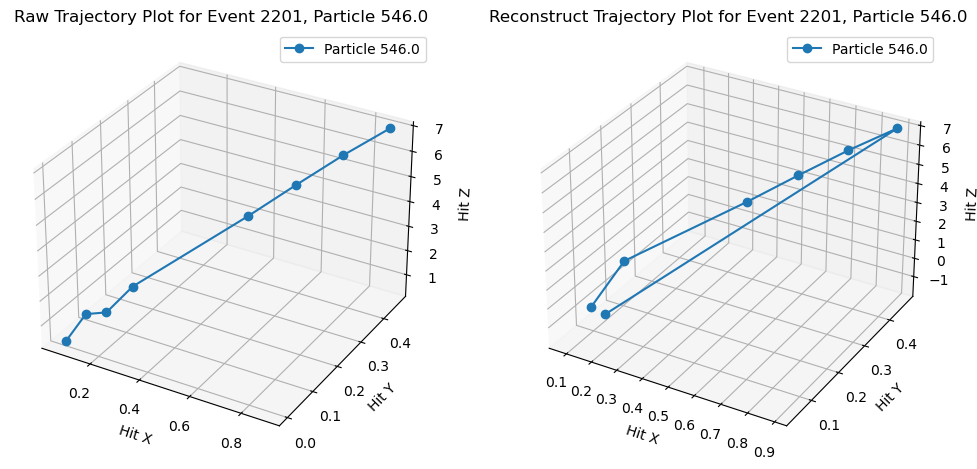

The angle between two particles in Event 2201: degree: 14.617365287852193, rad: 0.25512115223974946


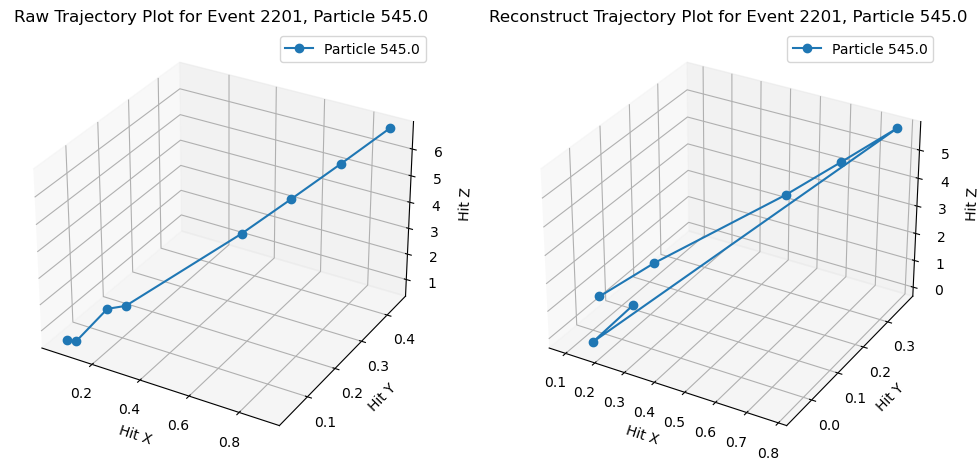

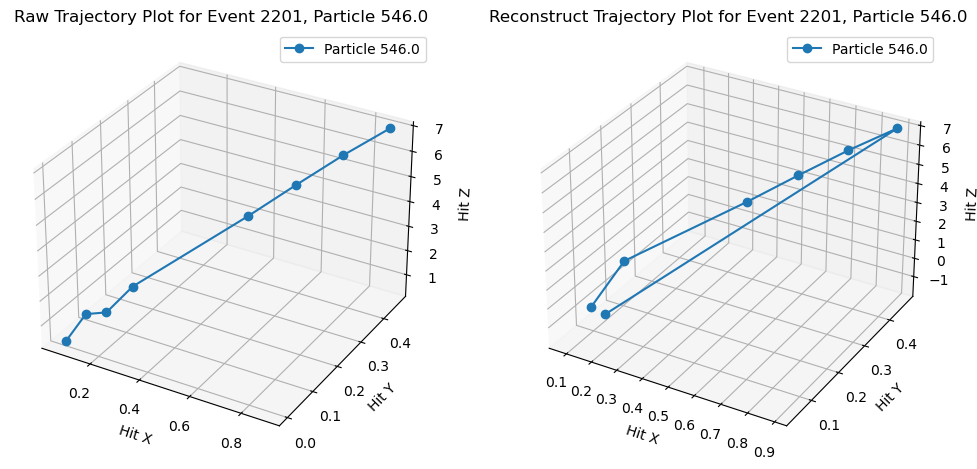

The angle between two particles in Event 2217: degree: 157.50274121099895, rad: 2.7489414150484928


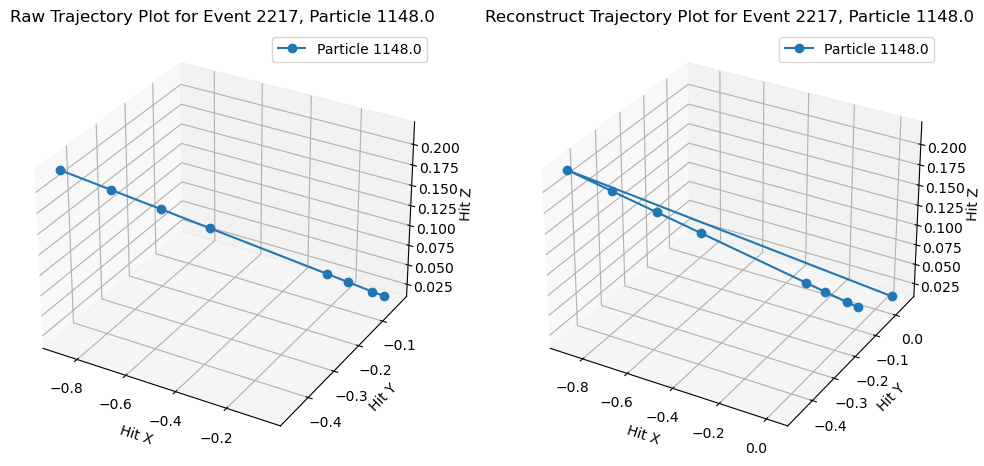

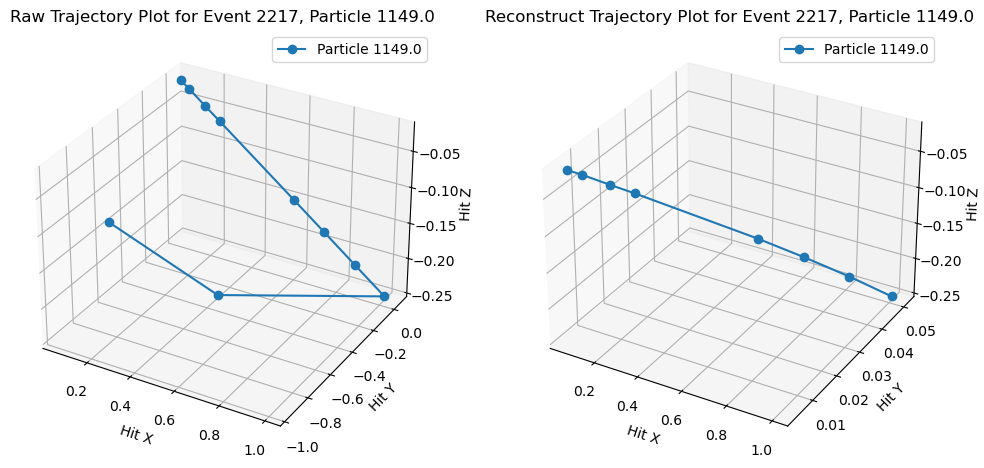

The angle between two particles in Event 2217: degree: 157.50274121099895, rad: 2.7489414150484928


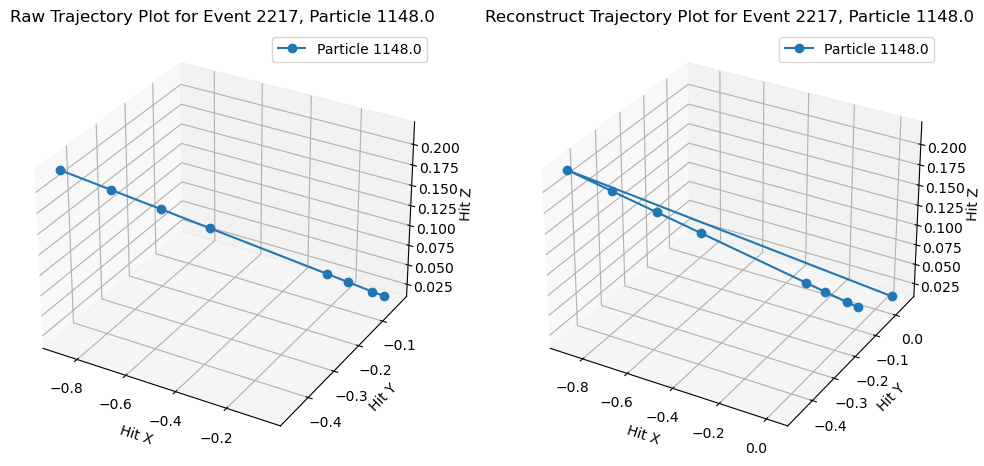

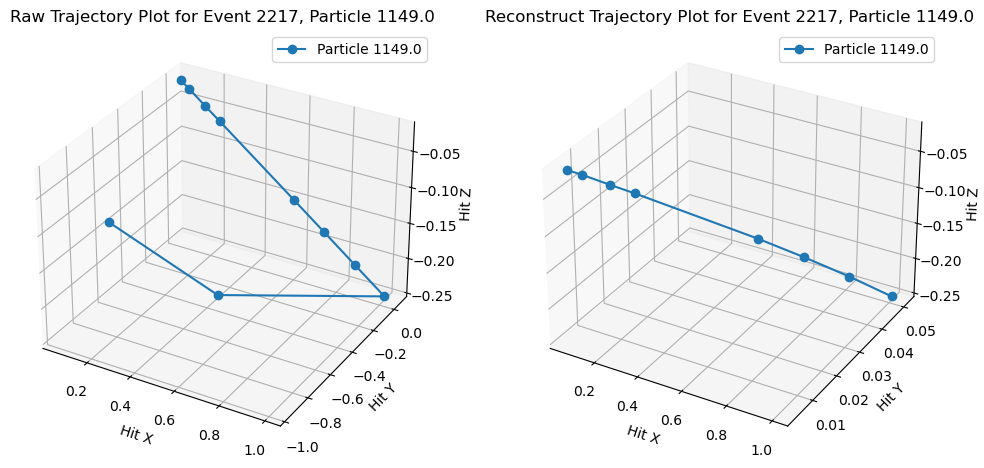

The angle between two particles in Event 2271: degree: 35.19221829325621, rad: 0.6142200802979002


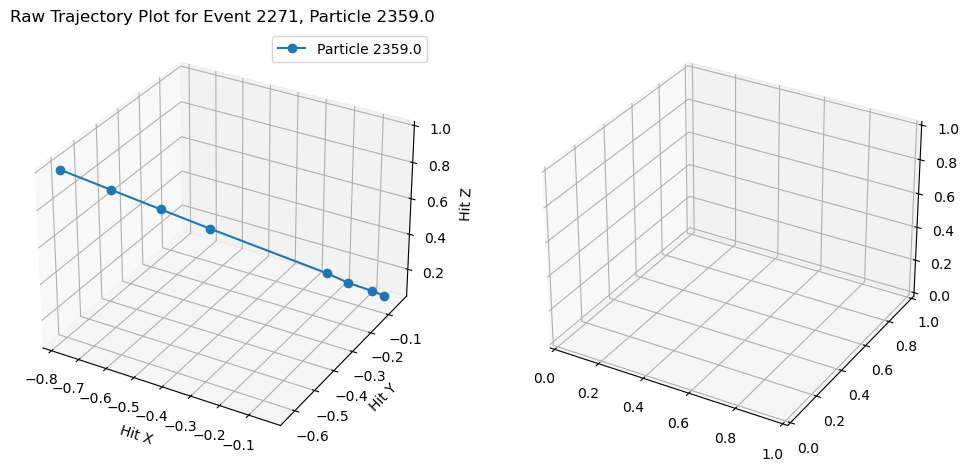

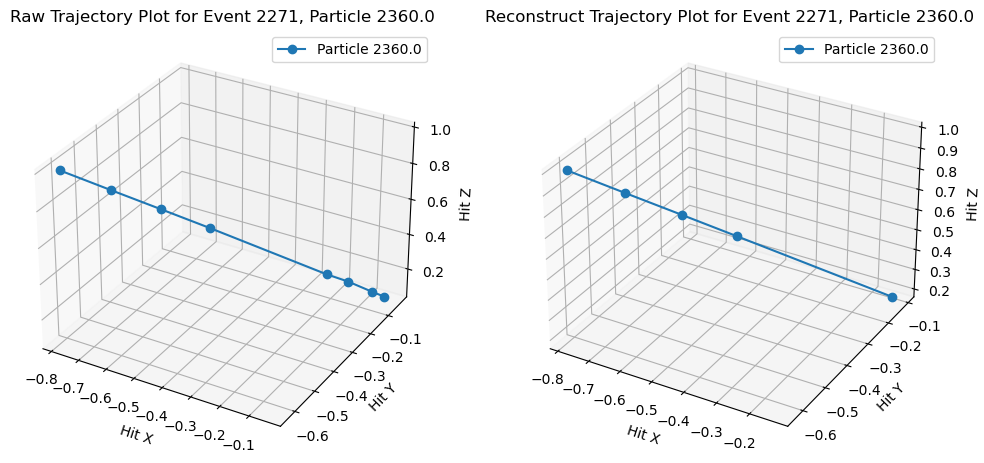

The angle between two particles in Event 2272: degree: 113.24416324933125, rad: 1.9764835073667906


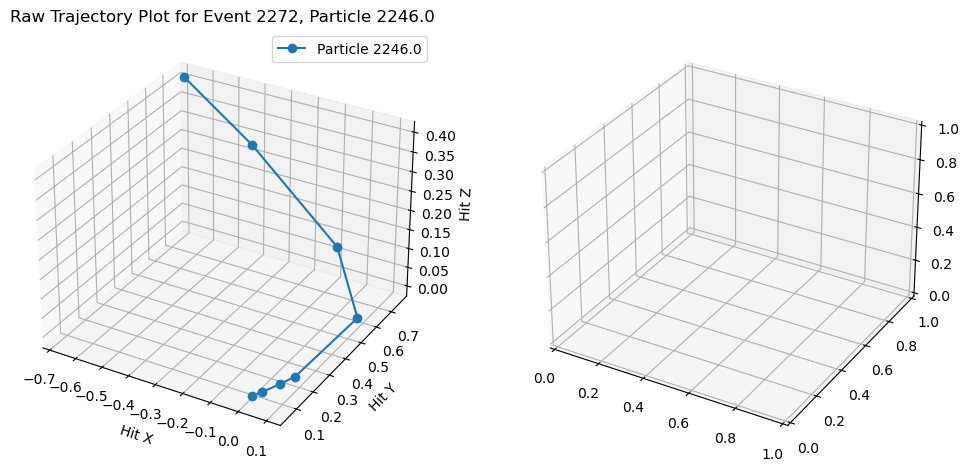

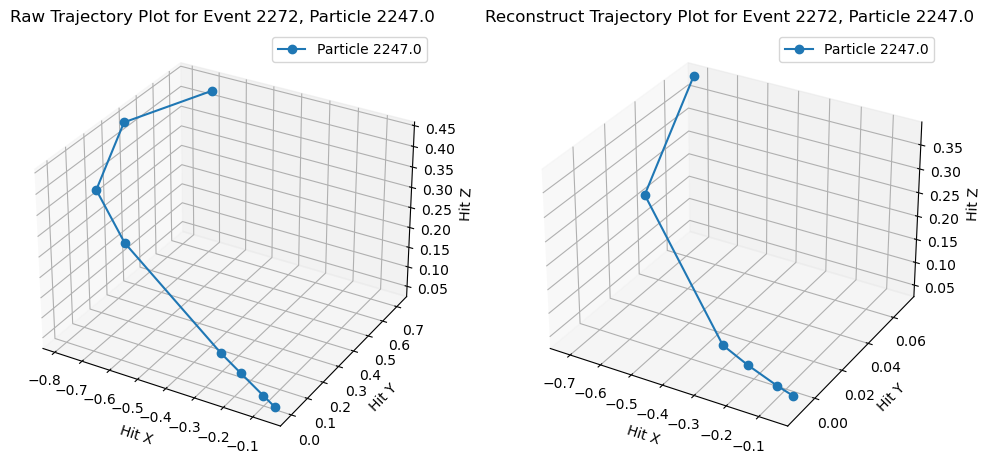

The angle between two particles in Event 2301: degree: 157.5213541453053, rad: 2.749266272035596


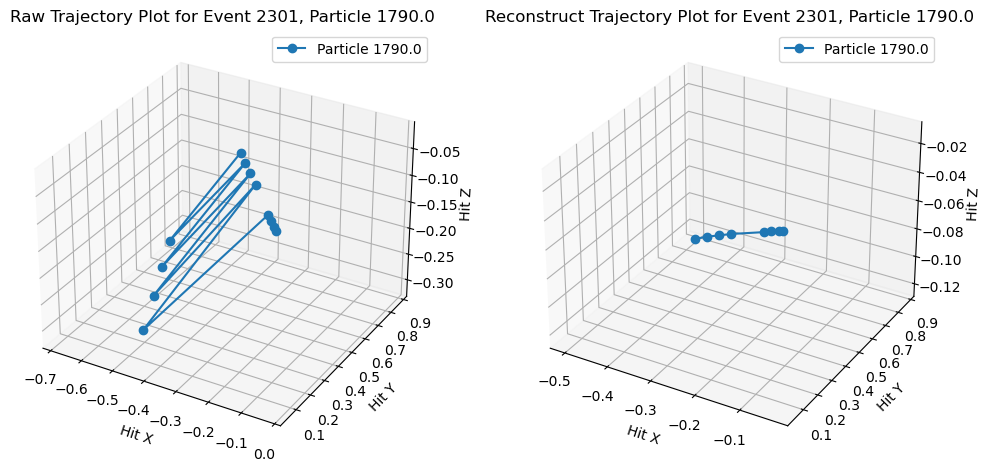

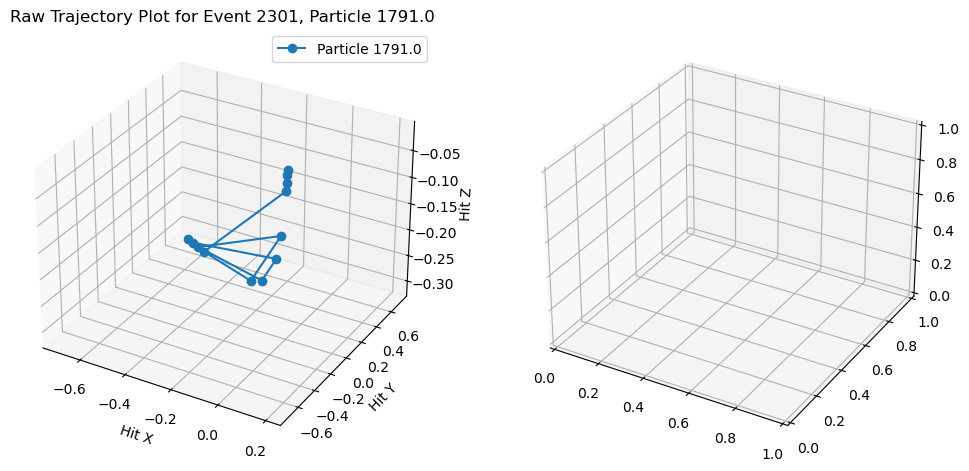

The angle between two particles in Event 2341: degree: 51.348189603441995, rad: 0.8961949735183843


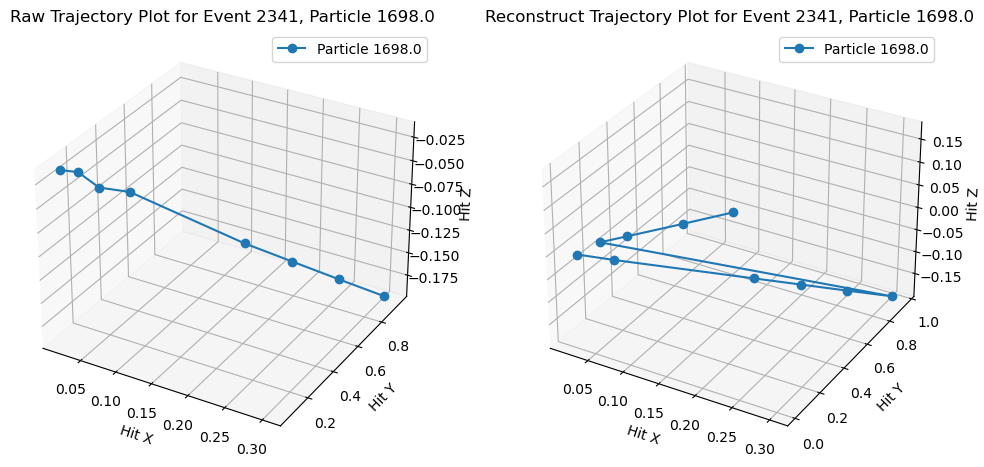

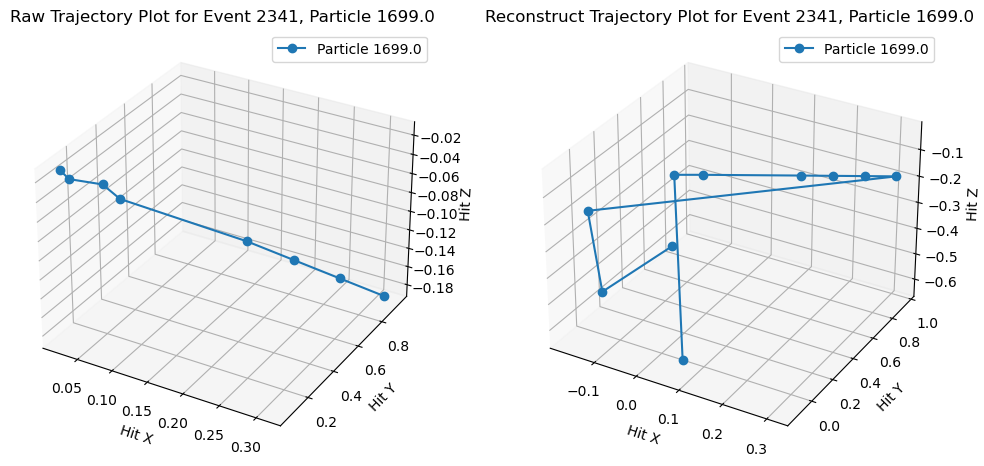

The angle between two particles in Event 2341: degree: 51.348189603441995, rad: 0.8961949735183843


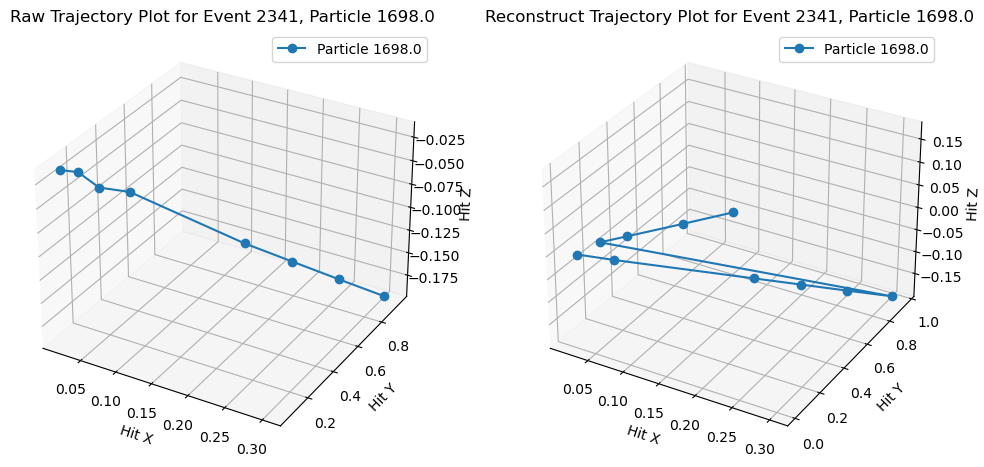

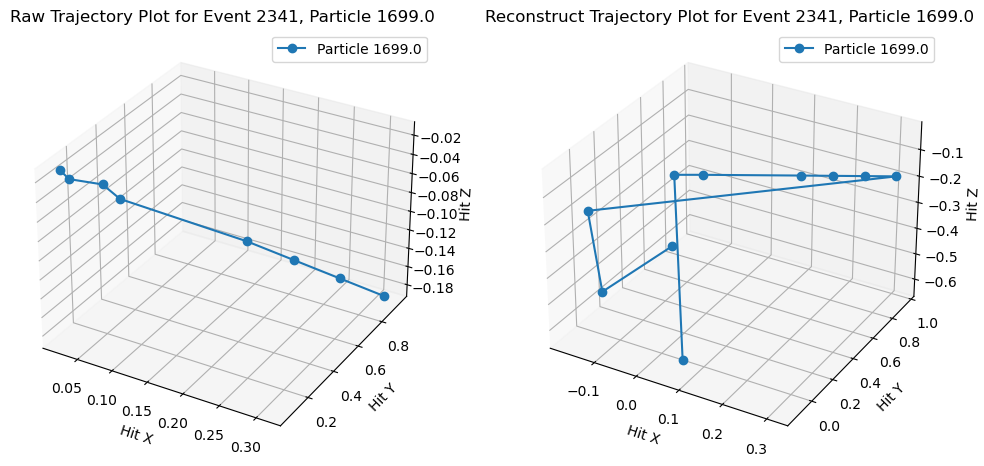

The angle between two particles in Event 2356: degree: 8.270181011919105, rad: 0.14434188839390477


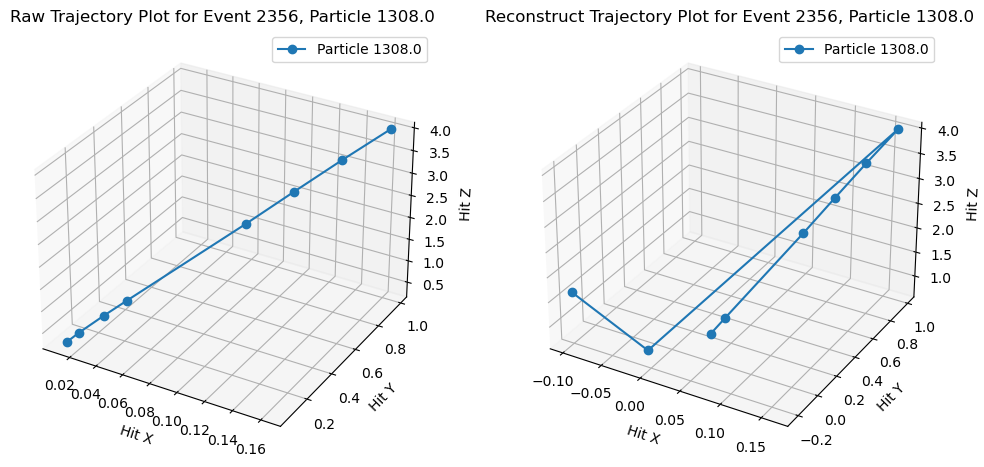

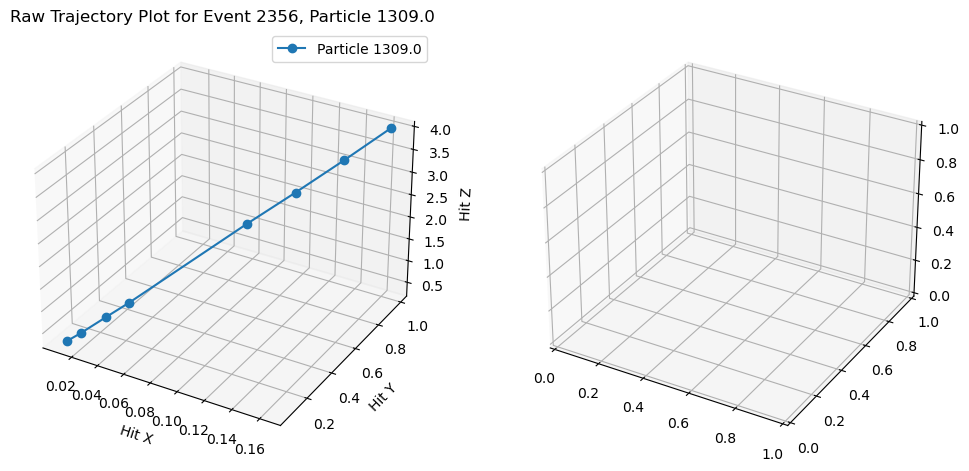

The angle between two particles in Event 2394: degree: 91.72150276541655, rad: 1.6008422181336028


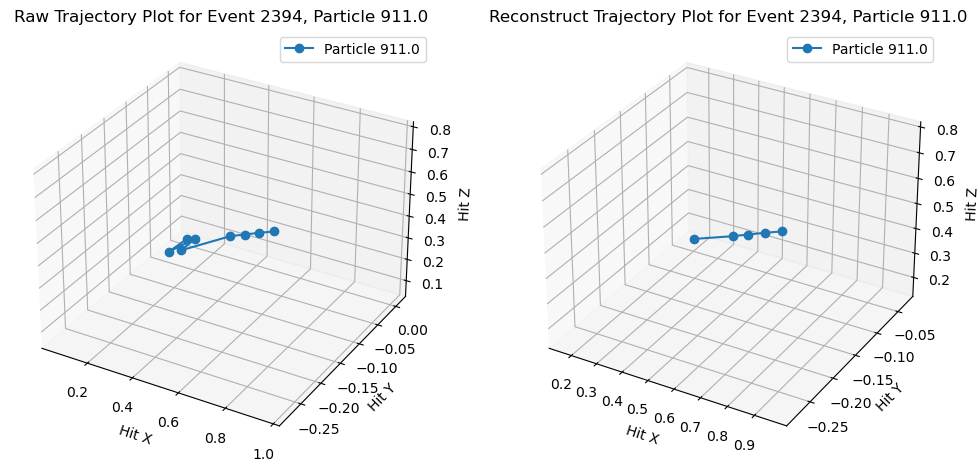

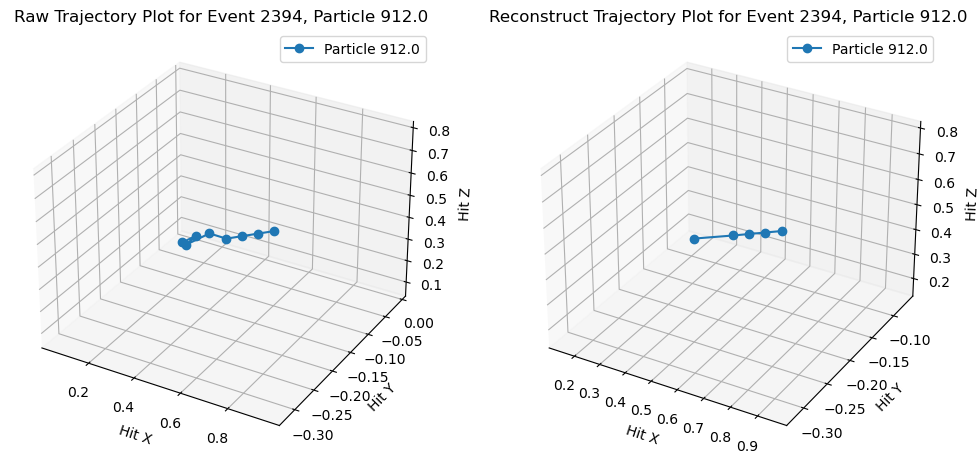

The angle between two particles in Event 2394: degree: 91.72150276541655, rad: 1.6008422181336028


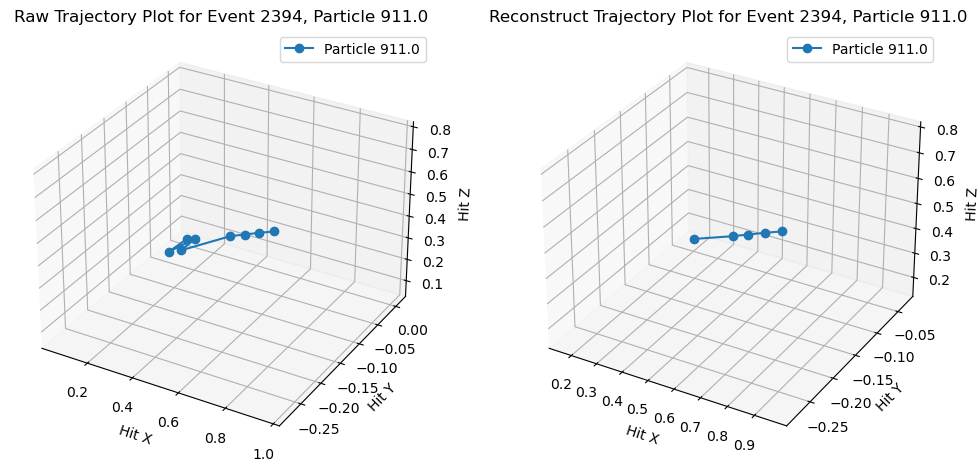

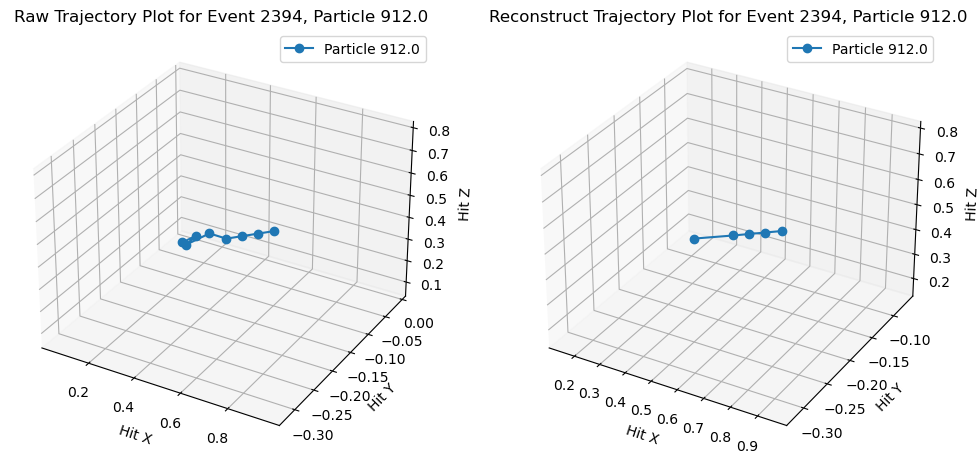

The angle between two particles in Event 2413: degree: 141.6170831232388, rad: 2.471684377571012


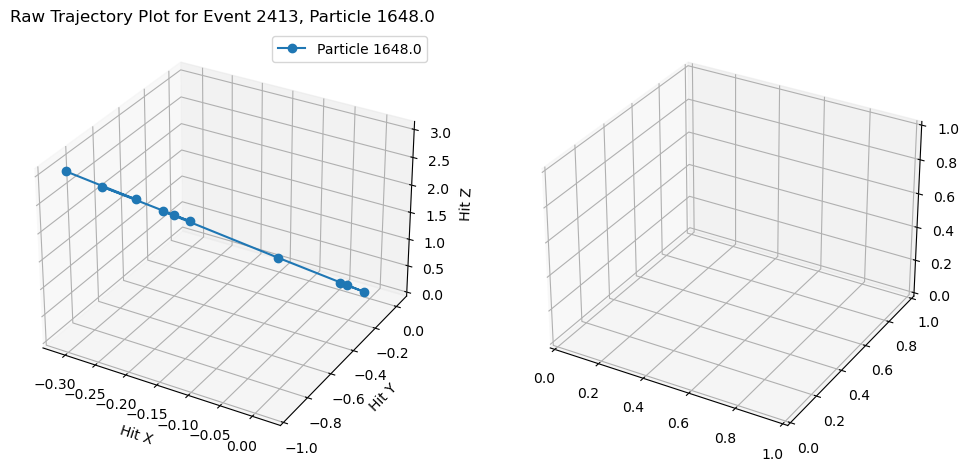

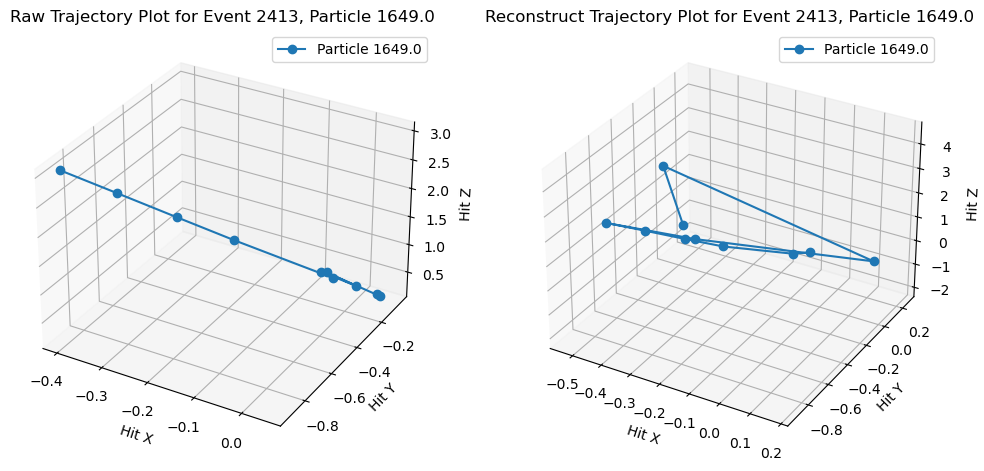

The angle between two particles in Event 2430: degree: 58.879336759082, rad: 1.0276382878365082


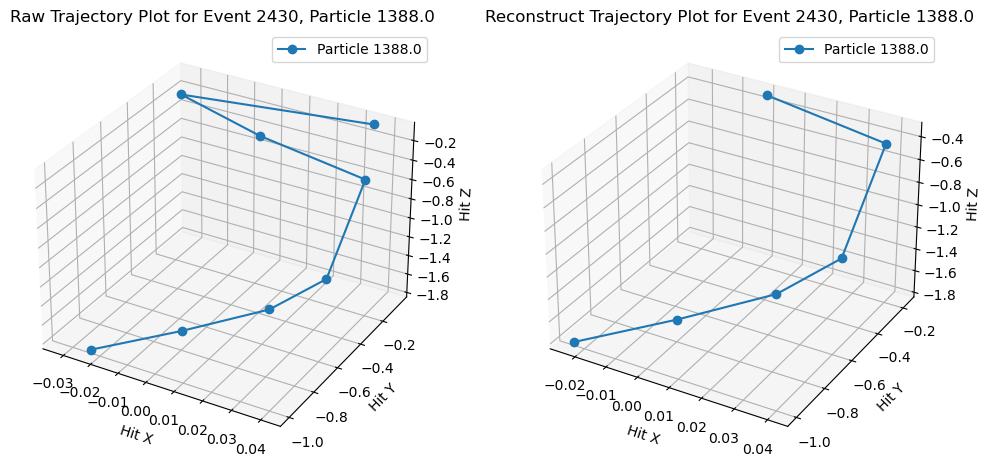

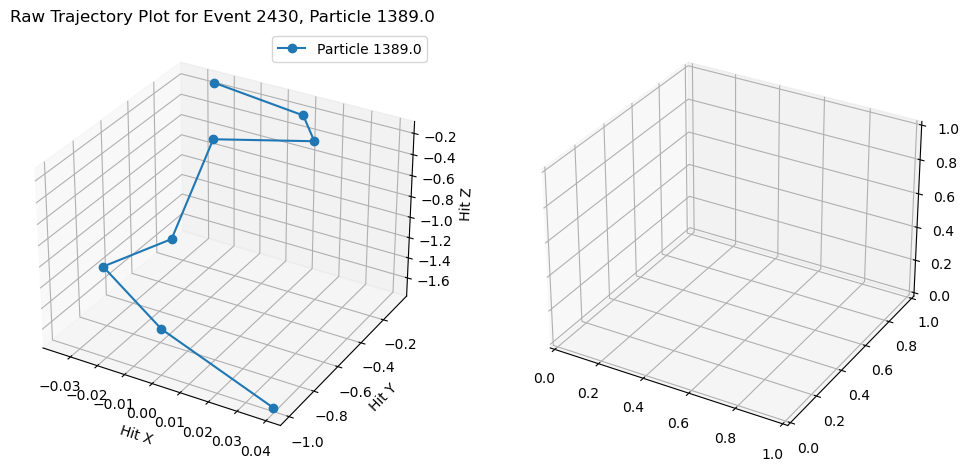

The angle between two particles in Event 2454: degree: 126.29608747236814, rad: 2.204282558779587


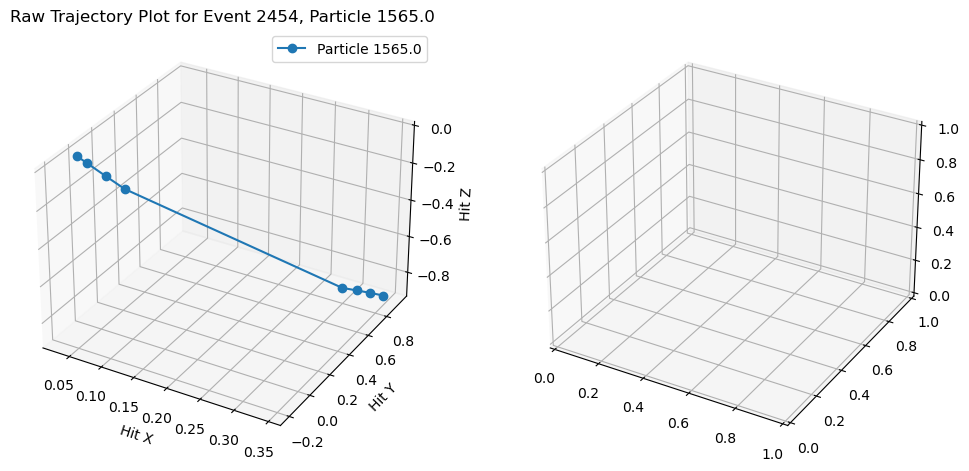

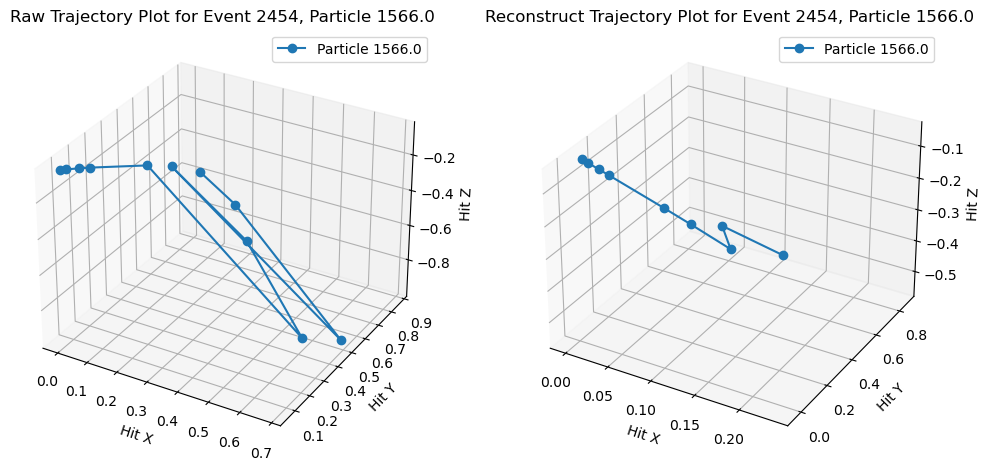

The angle between two particles in Event 2507: degree: 26.8387576503002, rad: 0.46842468814255533


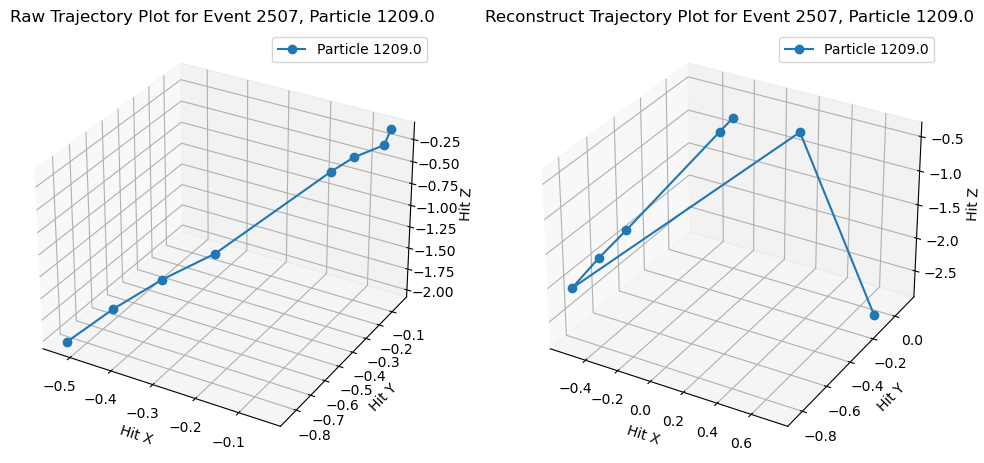

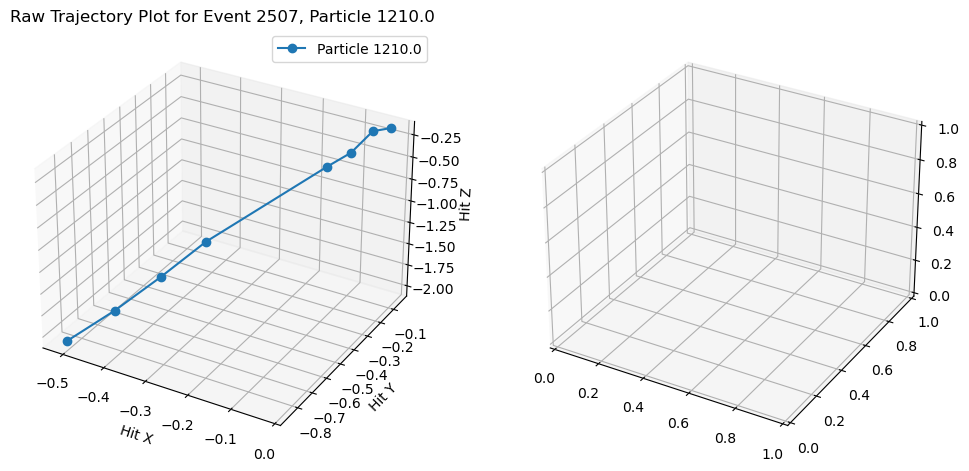

The angle between two particles in Event 2560: degree: 170.31458678661835, rad: 2.9725503036001193


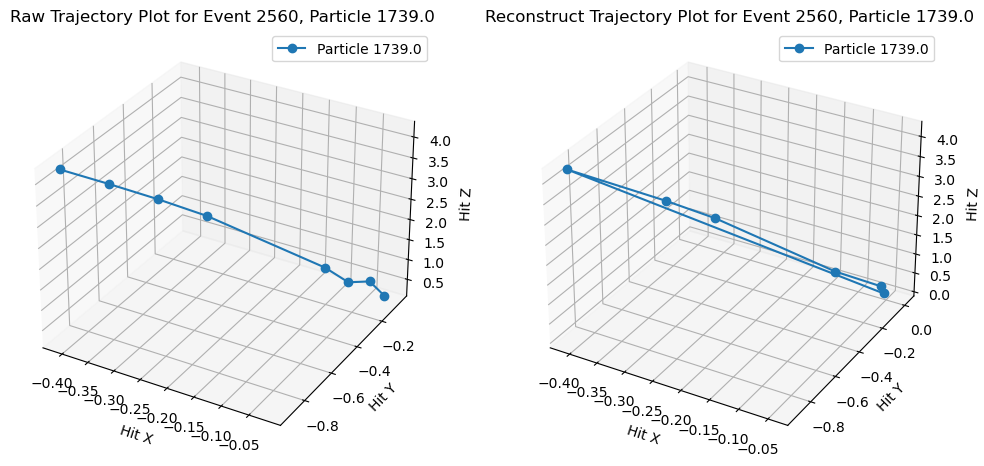

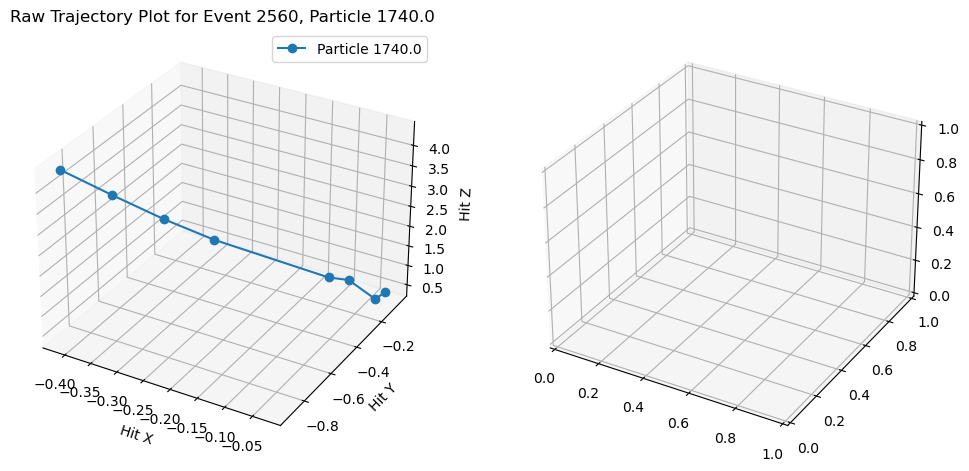

The angle between two particles in Event 2570: degree: 36.94462692141881, rad: 0.6448053806996946


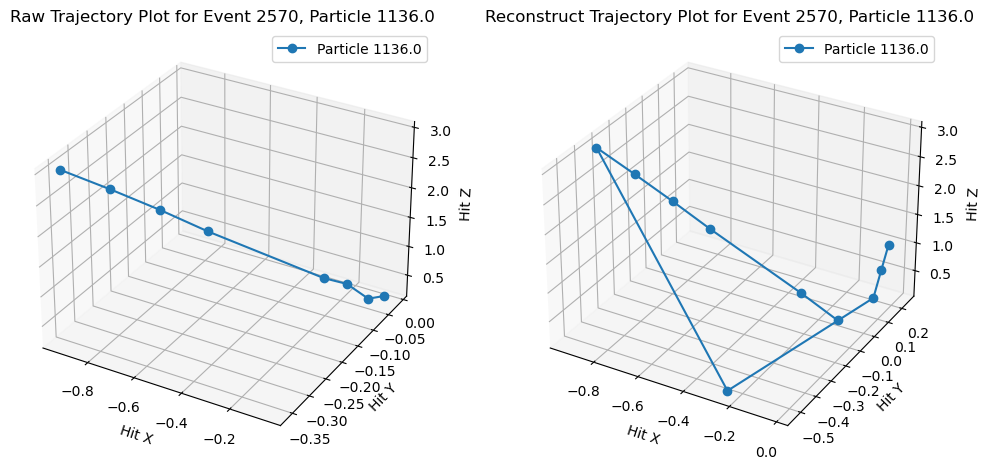

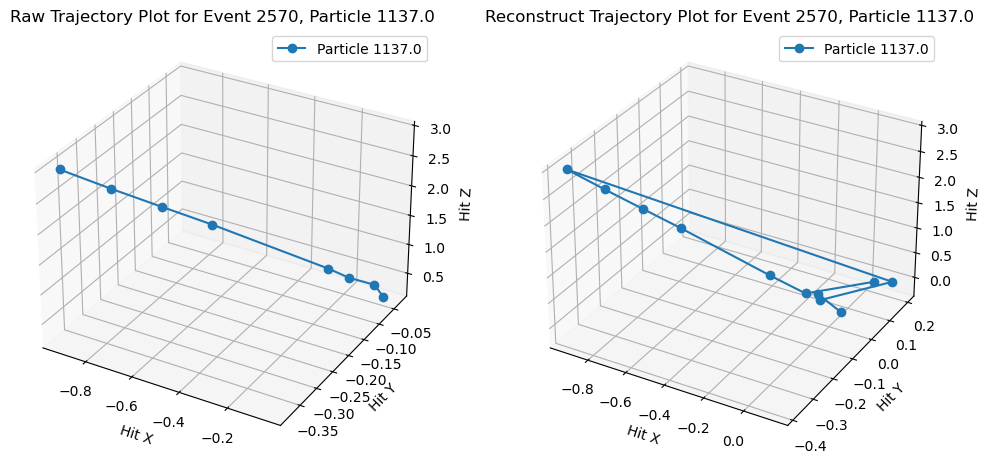

The angle between two particles in Event 2570: degree: 36.94462692141881, rad: 0.6448053806996946


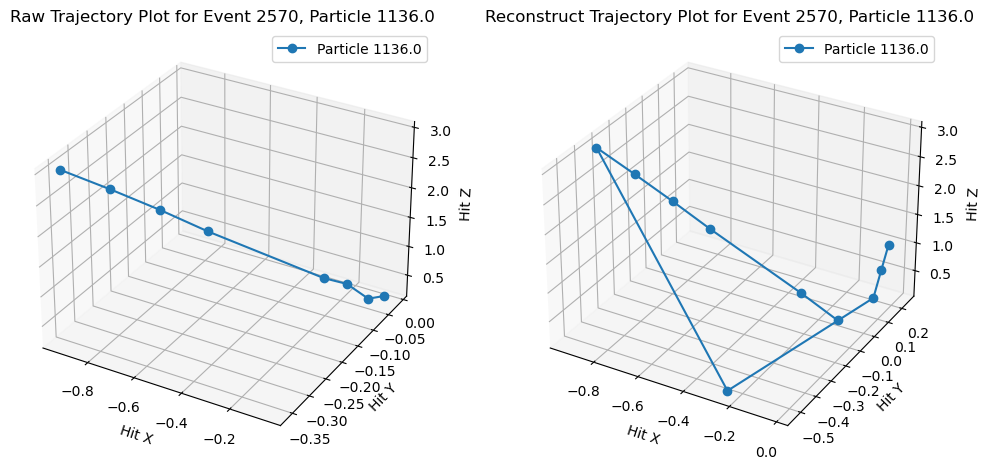

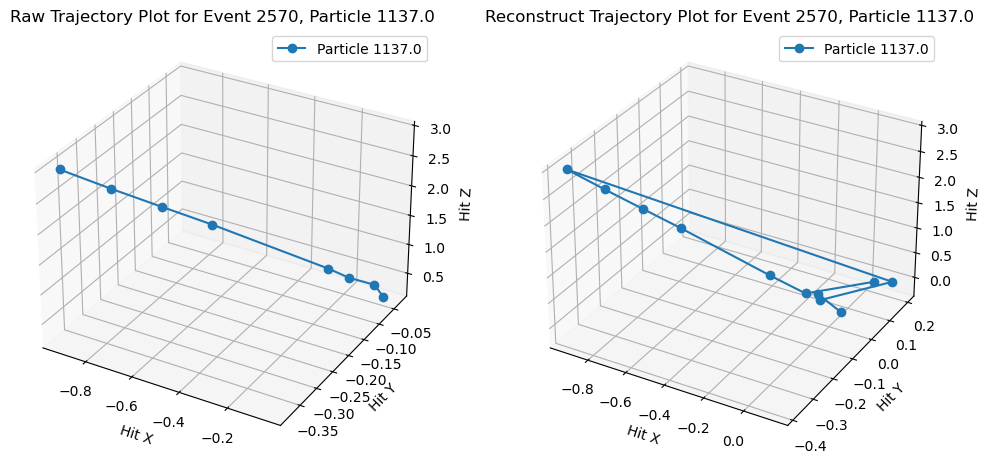

The angle between two particles in Event 2581: degree: 115.73182471964117, rad: 2.019901390698702


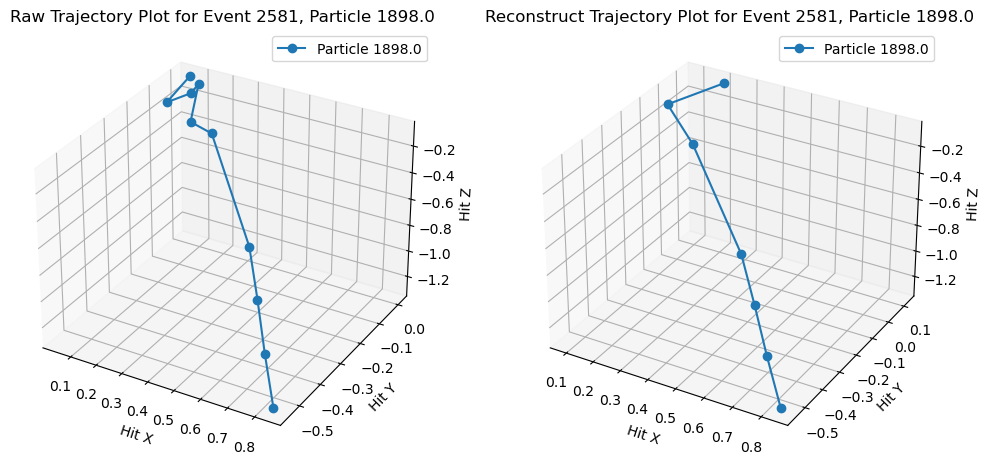

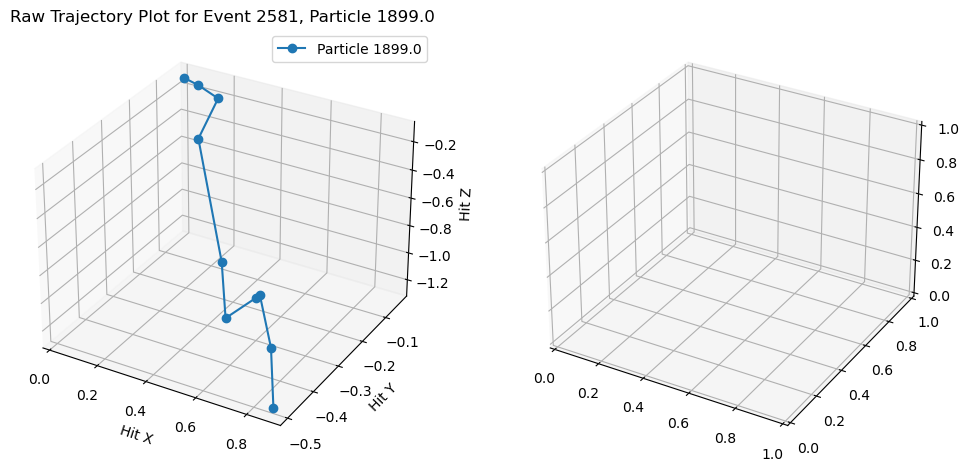

The angle between two particles in Event 2591: degree: 23.17879140786722, rad: 0.40454622670025486


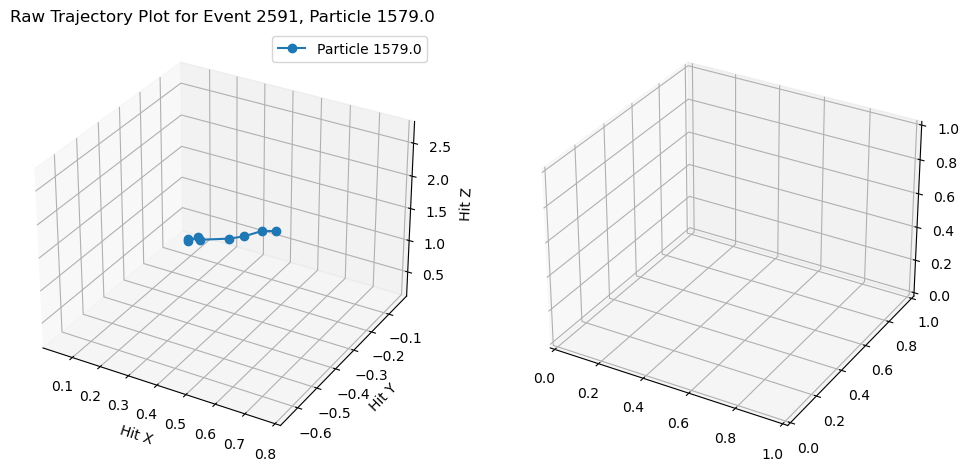

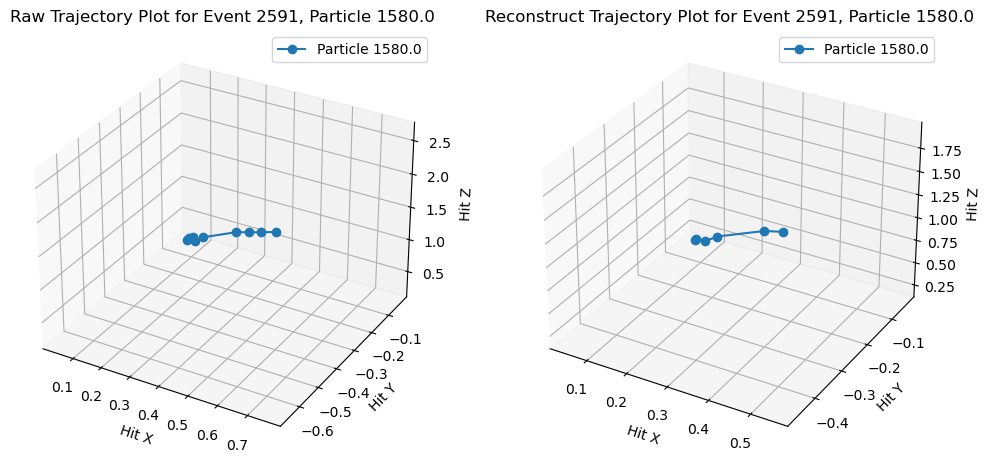

The angle between two particles in Event 2593: degree: 22.140561760573473, rad: 0.38642570096315954


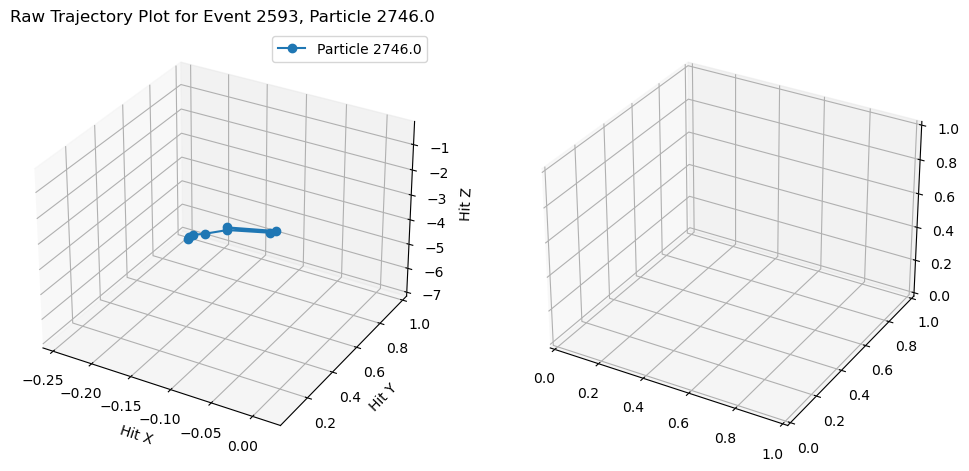

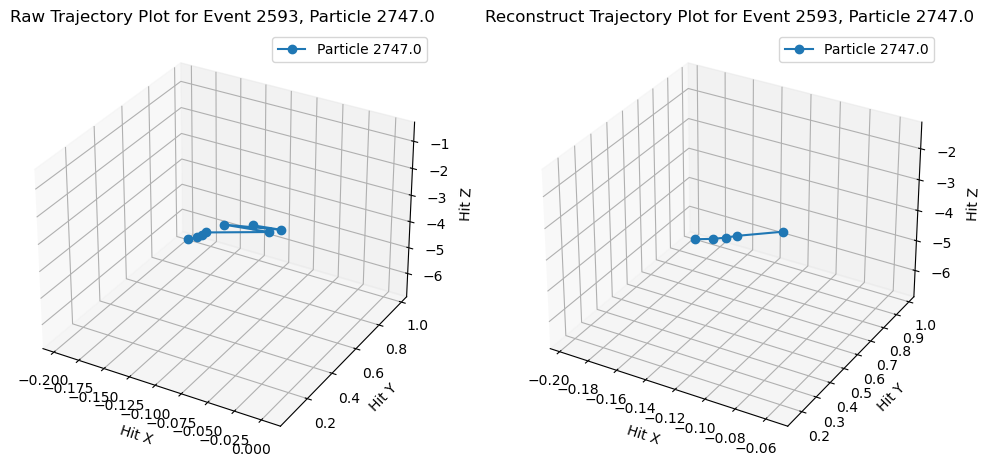

The angle between two particles in Event 2597: degree: 24.24362175937789, rad: 0.4231310223092847


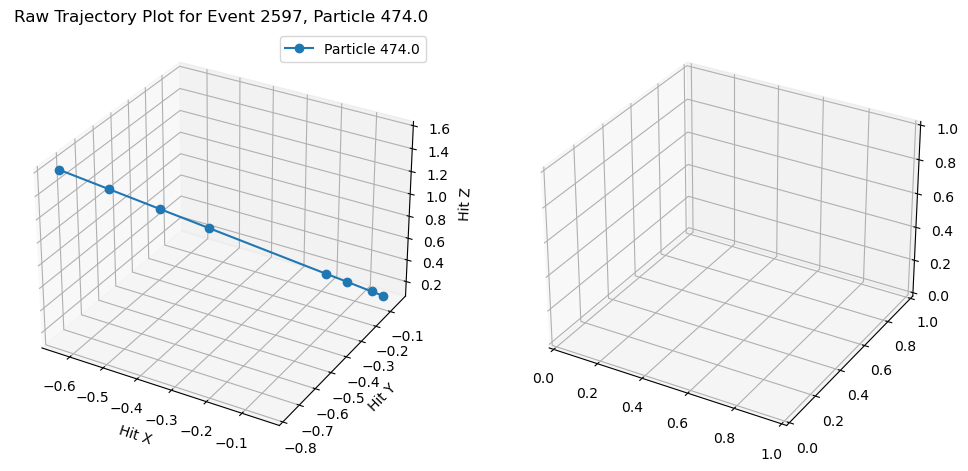

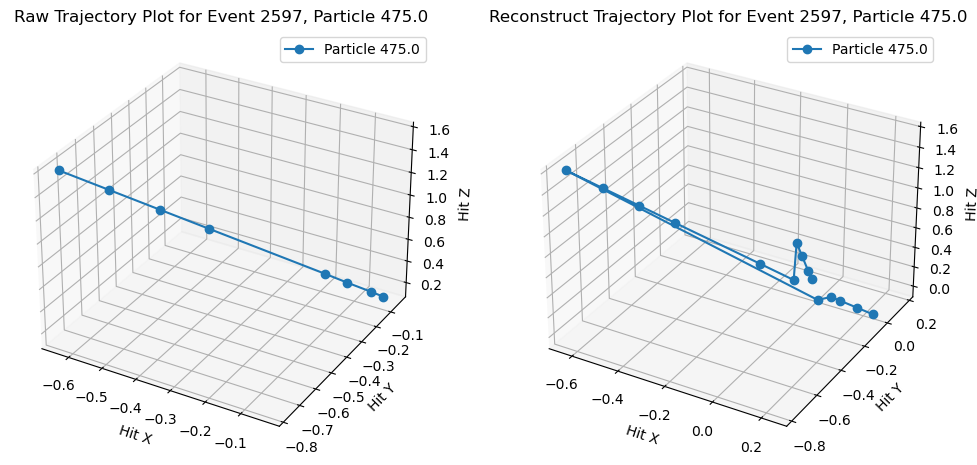

The angle between two particles in Event 2621: degree: 152.13000782809507, rad: 2.6551695276850067


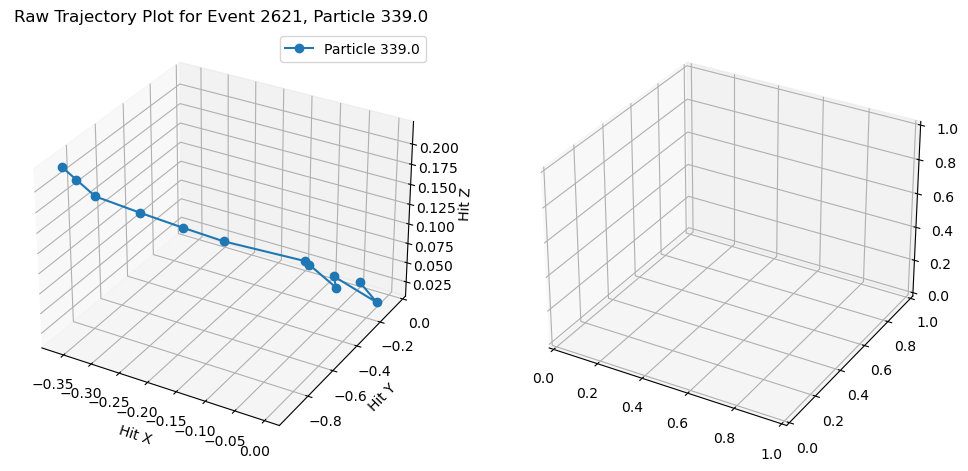

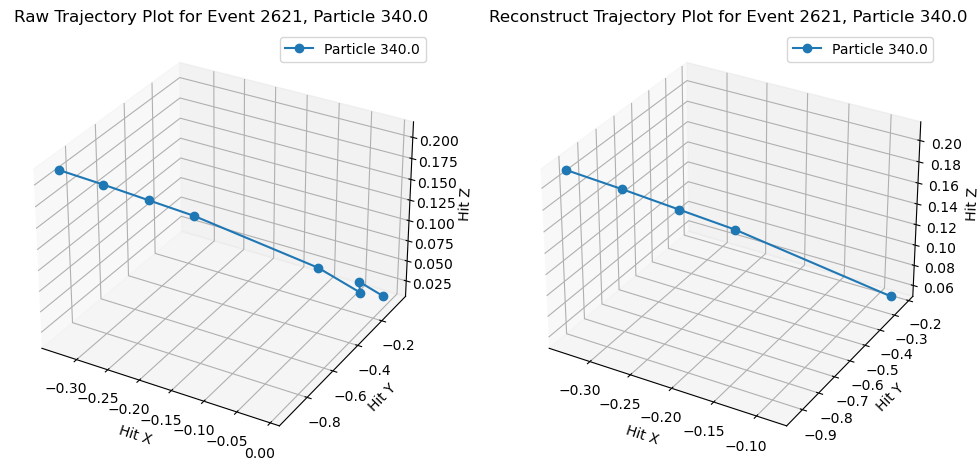

The angle between two particles in Event 2693: degree: 25.16564883121939, rad: 0.4392234305054411


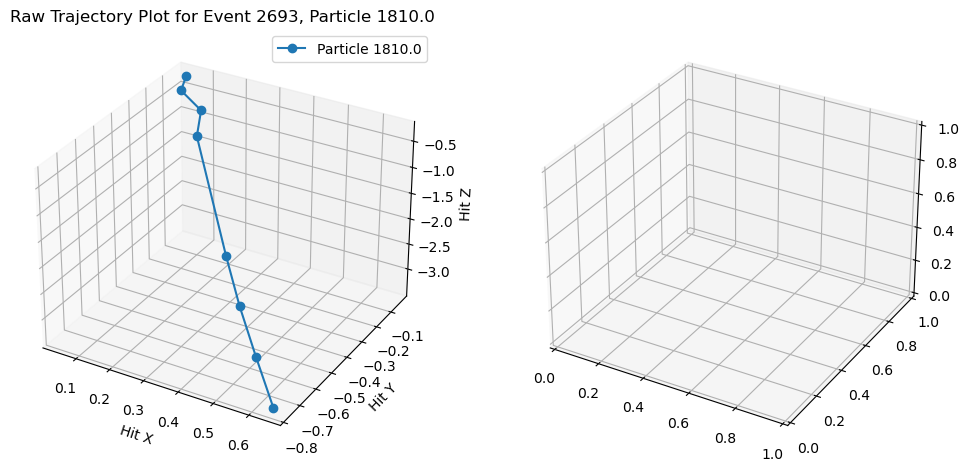

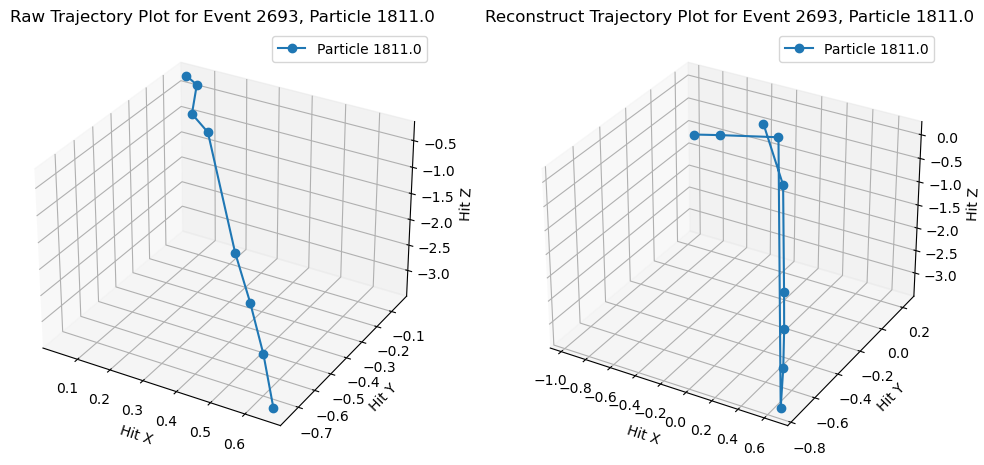

The angle between two particles in Event 2694: degree: 170.41646844909587, rad: 2.9743284740577574


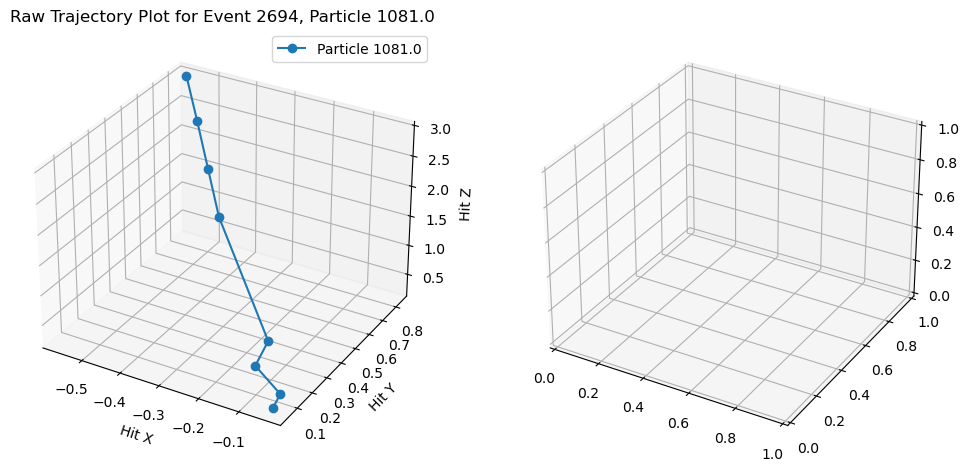

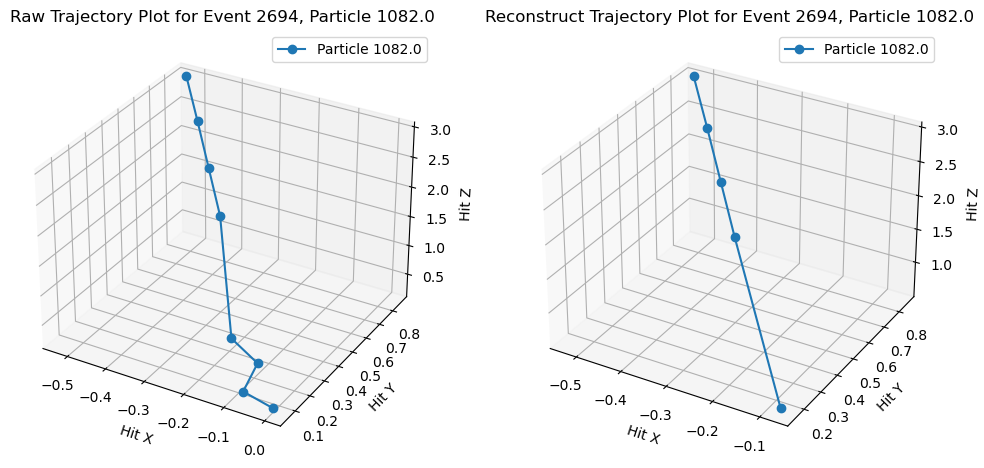

The angle between two particles in Event 2732: degree: 10.813442908572597, rad: 0.18873018223102397


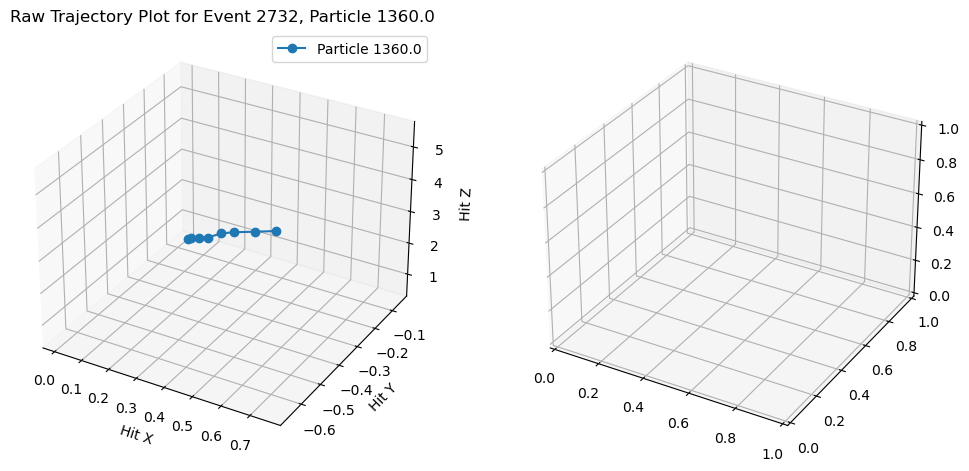

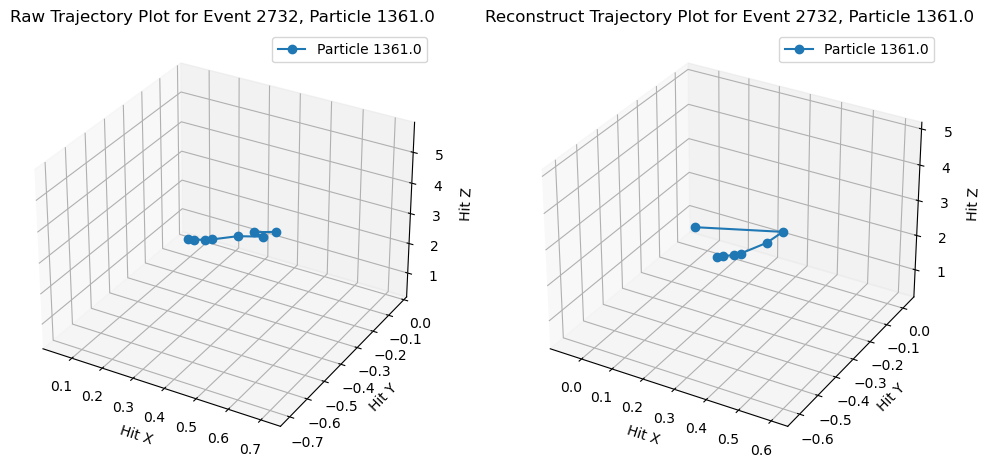

The angle between two particles in Event 2770: degree: 126.08281058291391, rad: 2.2005601748401986


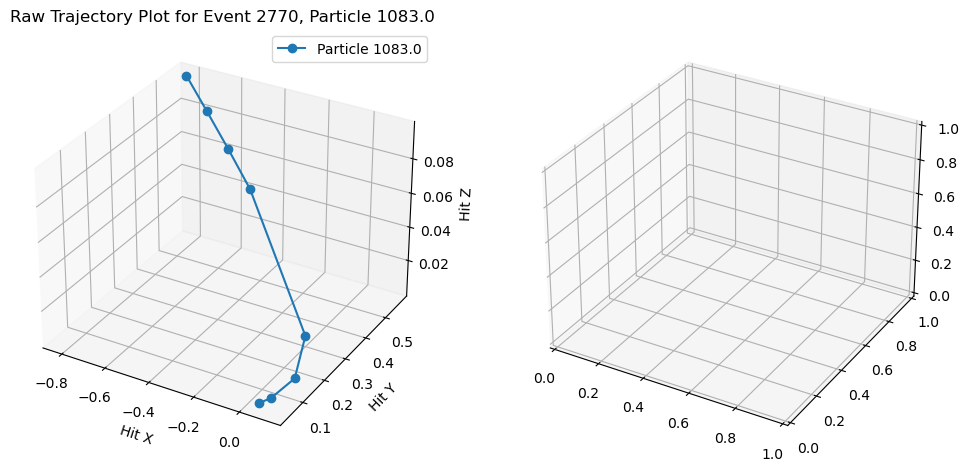

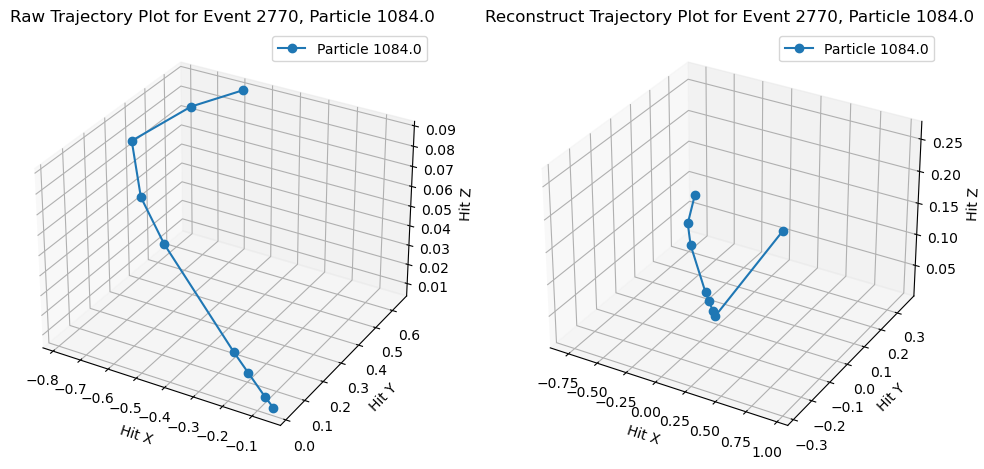

The angle between two particles in Event 2858: degree: 29.611237448617164, rad: 0.5168135890682147


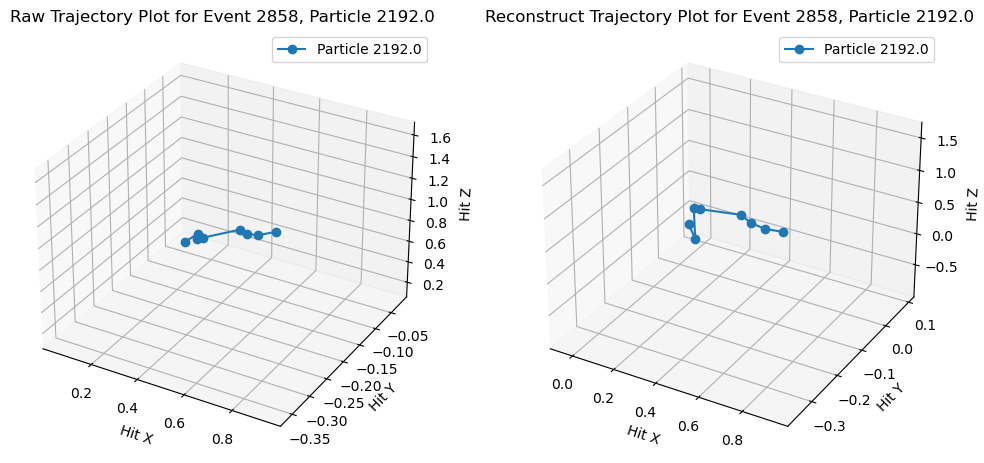

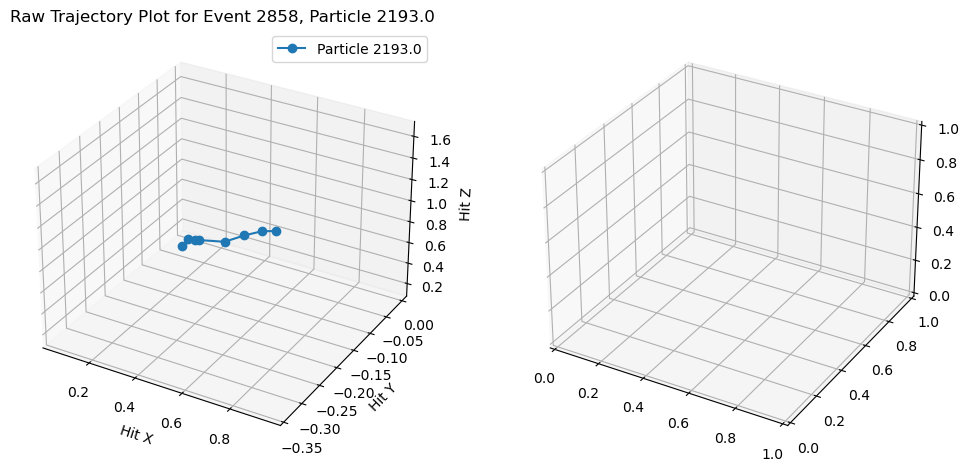

The angle between two particles in Event 2890: degree: 13.932186123060774, rad: 0.24316251984807438


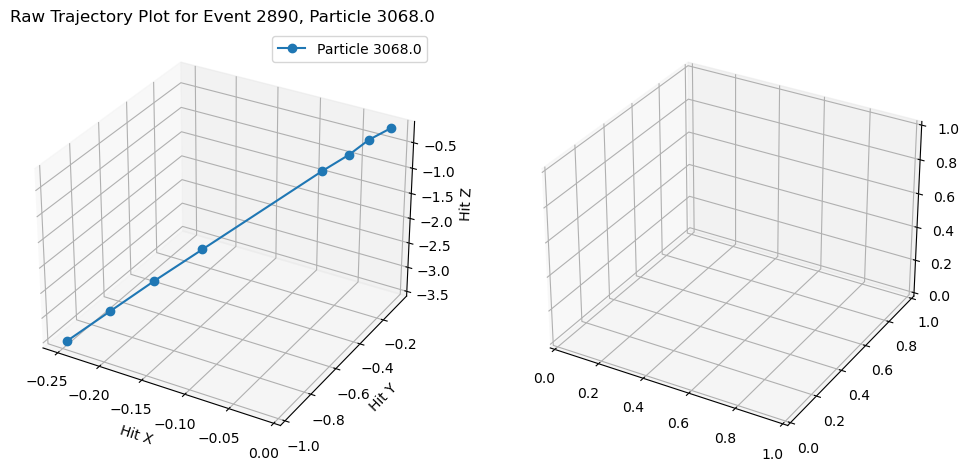

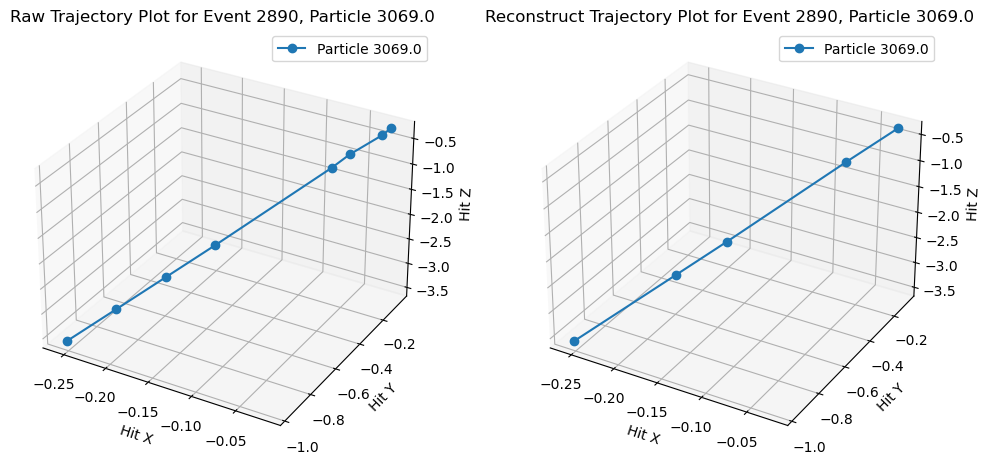

The angle between two particles in Event 2969: degree: 42.34564132389764, rad: 0.7390708649705844


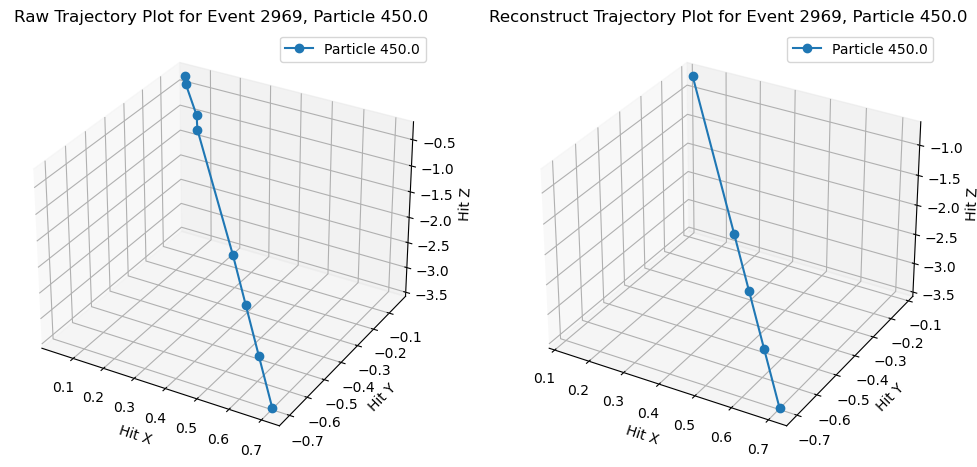

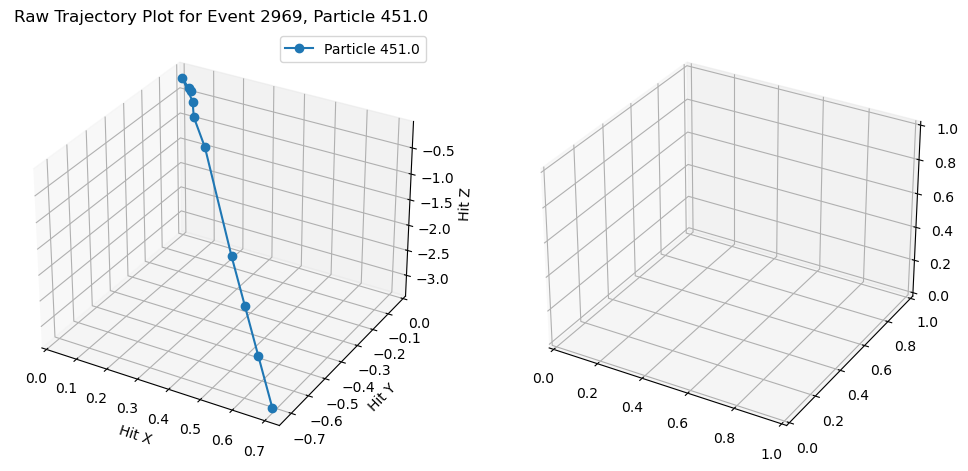

In [3]:
#Draw raw/reco plots

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import math
import os

output_directory = './plot/quirk_compare_event_id'
os.makedirs(output_directory, exist_ok=True)

def plot_individual_trajectories(df, event_number, df_reconstruct):
    grouped_data = df.groupby('particle_id')
    grouped_reco = df_reconstruct.groupby('particle_id')
    
    # 获取原始数据中的所有不同的particle_id
    particle_ids = df['particle_id'].unique()

    for particle_id in particle_ids:
        fig = plt.figure(figsize=(12, 6))

        # 添加两个子图，一个用于原始数据，一个用于reconstruct_data
        ax1 = fig.add_subplot(121, projection='3d')
        ax2 = fig.add_subplot(122, projection='3d')

        # 绘制原始数据的轨迹
        if particle_id in grouped_data.groups:
            group = grouped_data.get_group(particle_id)
            x = group['x']
            y = group['y']
            z = group['z']
            ax1.plot(x, y, z, marker='o', linestyle='-', label=f'Particle {particle_id}')
            ax1.set_xlabel('Hit X')
            ax1.set_ylabel('Hit Y')
            ax1.set_zlabel('Hit Z')
            ax1.set_title(f'Raw Trajectory Plot for Event {event_number}, Particle {particle_id}')
            ax1.legend()

        # 绘制reconstruct_data的轨迹
        if particle_id in grouped_reco.groups:
            group_reco = grouped_reco.get_group(particle_id)
            x_recon = group_reco['x']
            y_recon = group_reco['y']
            z_recon = group_reco['z']
            ax2.plot(x_recon, y_recon, z_recon, marker='o', linestyle='-', label=f'Particle {particle_id}')
            ax2.set_xlabel('Hit X')
            ax2.set_ylabel('Hit Y')
            ax2.set_zlabel('Hit Z')
            ax2.set_title(f'Reconstruct Trajectory Plot for Event {event_number}, Particle {particle_id}')
            ax2.legend()

        output_file_path = os.path.join(output_directory, f'E{event_number}_Pid{particle_id}.png')
        plt.savefig(output_file_path)
        
        plt.show()
        
        
df_quirk = pd.read_csv('./output/track_quirk_2000.csv')
reconstruct_data = df_quirk.drop_duplicates(subset=['particle_id'])
event_file_array = reconstruct_data['event_id'].to_numpy()[:40]
# 循环处理每个 event_number
for event_number in event_file_array:
    file_hit_name = f"../QuirkTracking/datasets/Lambda500/Quirk/event00000{event_number}-hits.csv"
    df = pd.read_csv(file_hit_name)
    df['r'] = (df['r']) / 51.4
    df['x'] = (df['r']) * np.cos(df['phi'])
    df['y'] = (df['r']) * np.sin(df['phi'])
    df['z'] = df['z'] / 100.

    # 读取CSV文件并计算角度
    file_particle_name = f"../QuirkTracking/datasets/Lambda500/Quirk/event00000{event_number}-particles.csv"
    dfp = pd.read_csv(file_particle_name)
    particle1 = dfp.iloc[0][['px', 'py', 'pz']]
    particle2 = dfp.iloc[1][['px', 'py', 'pz']]
    magnitude1 = np.linalg.norm(particle1)
    magnitude2 = np.linalg.norm(particle2)
    cosine_theta = np.dot(particle1, particle2) / (magnitude1 * magnitude2)
    angle_radians = math.acos(cosine_theta)
    angle_degrees = math.degrees(angle_radians)
    print(f"The angle between two particles in Event {event_number}: degree: {angle_degrees}, rad: {angle_radians}")

    # 获取reconstruct_data的数据
    df_reconstruct = df_quirk[df_quirk['event_id'] == event_number]

    # 为每个particle_id创建原始轨迹和重建轨迹的子图
    plot_individual_trajectories(df, event_number, df_reconstruct)
    
    

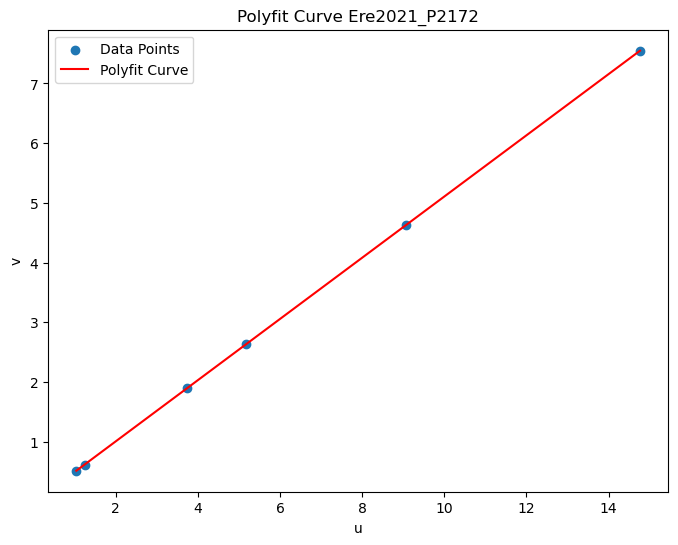

/tmp/qsha/ipykernel_4122425/1680891873.py:57: RuntimeWarning: invalid value encountered in arccos
  theta = np.arccos(cos_val)


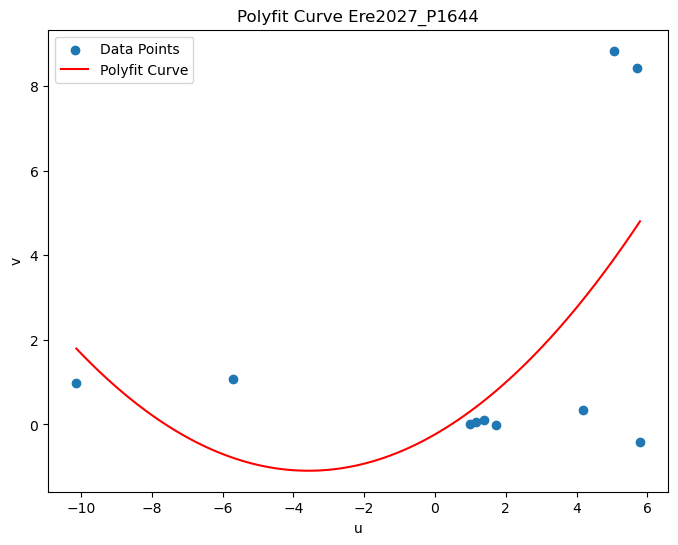

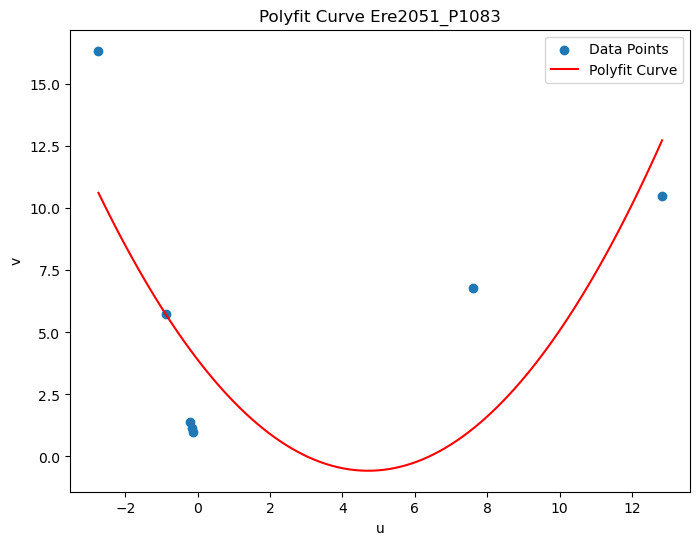

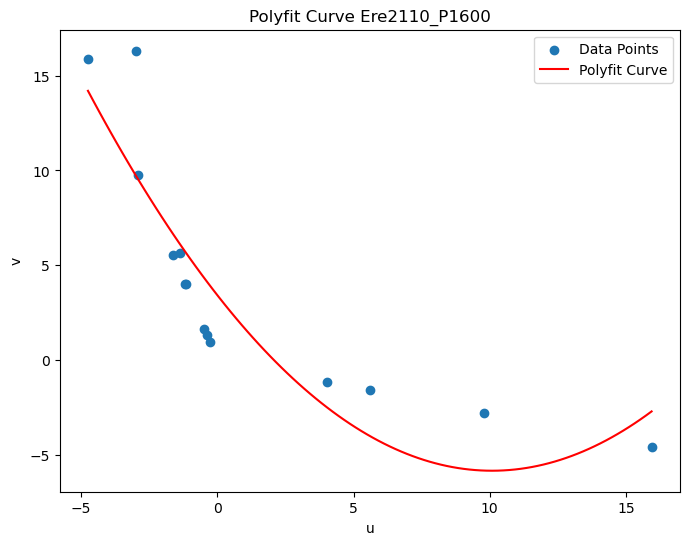

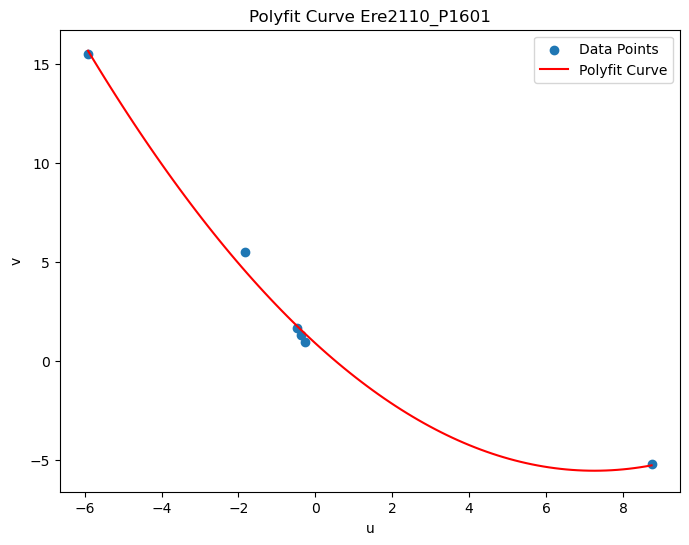

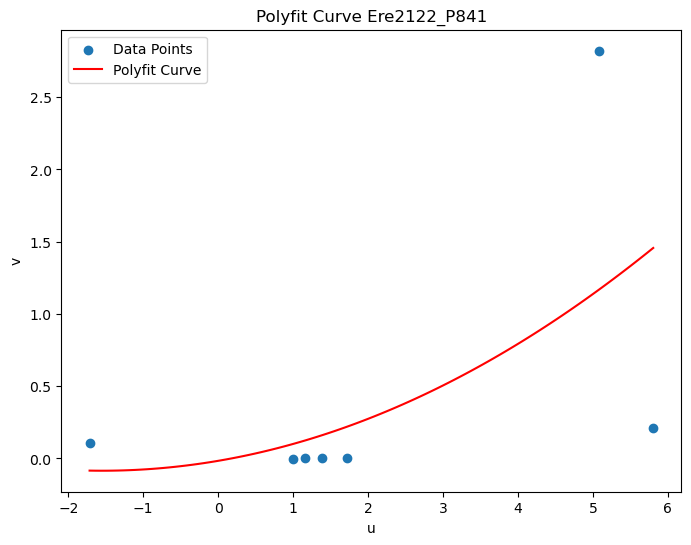

...

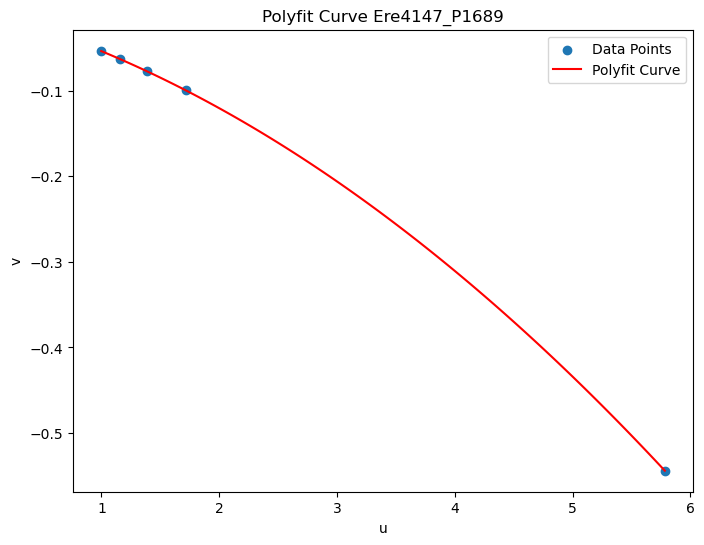

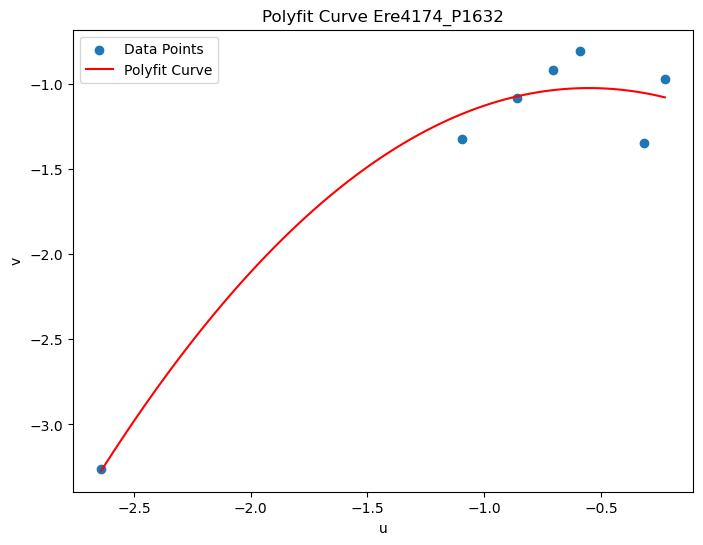

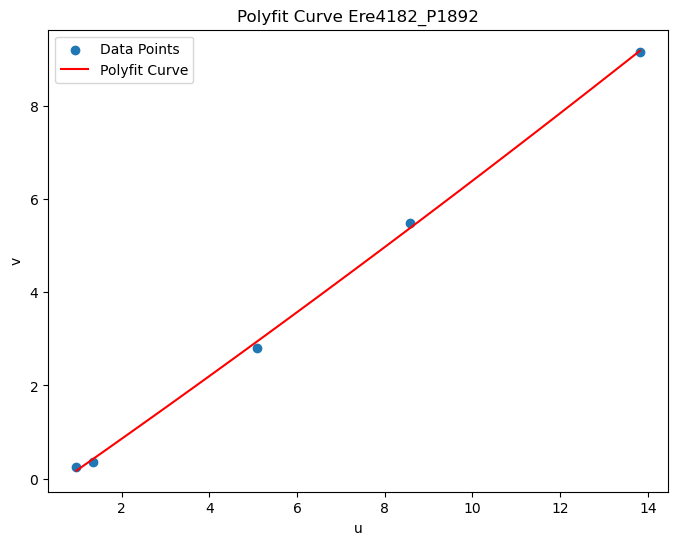

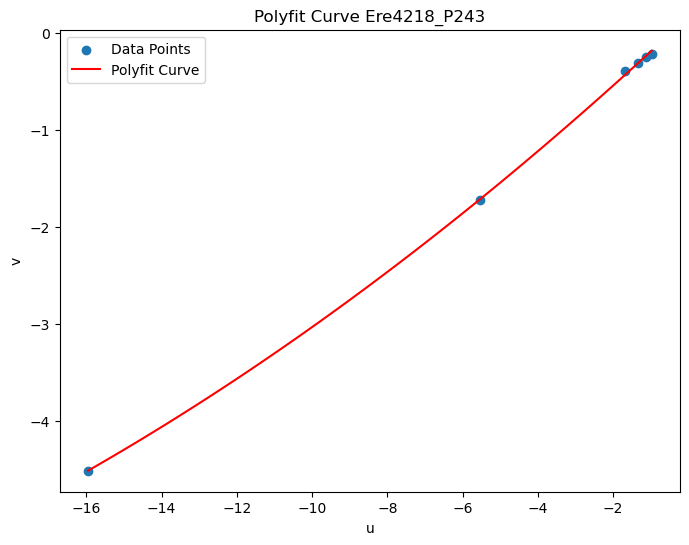

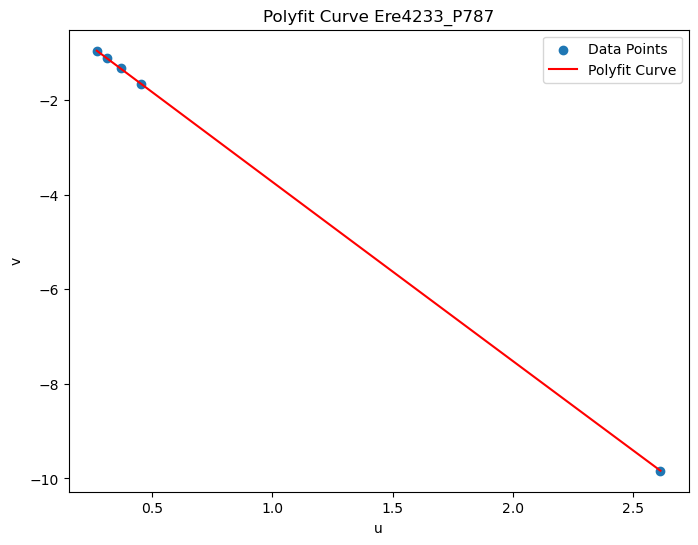

In [26]:
import numpy as np
import pandas as pd
import torch
import matplotlib.pyplot as plt

def conformal_mapping(file):
    # 在这里实现你的拟合逻辑，包括计算 a、b、R、e、pT 等参数
    """
    x, y, z: np.array([])
    return: 
    """
    
    # ref. 10.1016/0168-9002(88)90722-X
    # choose the dataset with different particle_id
    df = pd.read_csv(file)

# 分组数据并进行拟合
    grouped = df.groupby(['event_id', 'particle_id'])
    for group_key, group_data in grouped:
        # 获取分组的 x、y、z、r 数据
        x = group_data['x'].to_numpy()
        y = group_data['y'].to_numpy()
        z = group_data['z'].to_numpy()
        event_id = group_data['event_id'].unique()
        particle_id = group_data['particle_id'].unique()

        r = x**2 + y**2
        u = x / r
        v = y / r
        # assuming the imapact parameter is small
        # the v = 1/(2b) - u x a/b - u^2 x epsilon x (R/b)^3
        pp, vv = np.polyfit(u, v, 2, cov=True)
        b = 0.5/pp[2]
        a = -pp[1]*b
        R = np.sqrt(a**2 + b**2)
        e = -pp[0] / (R/b)**3 # approximately equals to d0
        dev = 2*e*R / b**2

        magnetic_field = 2.0
        pT = 0.3*magnetic_field*R # in MeV
        # print(a, b, R, e, pT)

        p_rz = np.polyfit(np.sqrt(r), z, 2)
        y_p_rz = np.polyval(p_rz, np.sqrt(r))
        residuals = z - y_p_rz
        chi_square = np.sum((residuals / y_p_rz)**2)

        y_p_rz = np.polyval(p_rz, np.sqrt(r))
    
        pp_rz = np.poly1d(p_rz)
        z0 = pp_rz(abs(e))

        r3 = np.sqrt(r + z**2)
        p_zr = np.polyfit(r3, z, 2)
    
        cos_val = p_zr[0]*z0 + p_zr[1]
        theta = np.arccos(cos_val)
        eta = -np.log(np.tan(theta/2.))
        phi = np.arctan2(b, a)
  
        u_fit = np.linspace(u.min(), u.max(), 100)  # 生成用于绘制拟合曲线的数据点
        v_fit = np.polyval(pp, u_fit)  # 计算拟合曲线的值

        plt.figure(figsize=(8, 6))
        plt.scatter(u, v, label='Data Points')
        plt.plot(u_fit, v_fit, label='Polyfit Curve', color='red')
        plt.xlabel('u')
        plt.ylabel('v')
        plt.title(f'Polyfit Curve Ere{int(event_id)}_P{int(particle_id)}')
        plt.legend()
        
        output_folder = './plot/fit_event_id'
        os.makedirs(output_folder, exist_ok=True)

        # Save the plot to a file
        plot_filename = os.path.join(output_folder, f'Polyfit_Ere{int(event_id)}_P{int(particle_id)}.png')
        plt.savefig(plot_filename)
        plt.show()
        plt.close()  # Close the plot to release resources
  
   
    return a, b, R, e, pT

# 读取 CSV 文件并提取所需的列
file = f'./output/track_quirk_2000.csv'
a, b, R, e, pT = conformal_mapping(file)


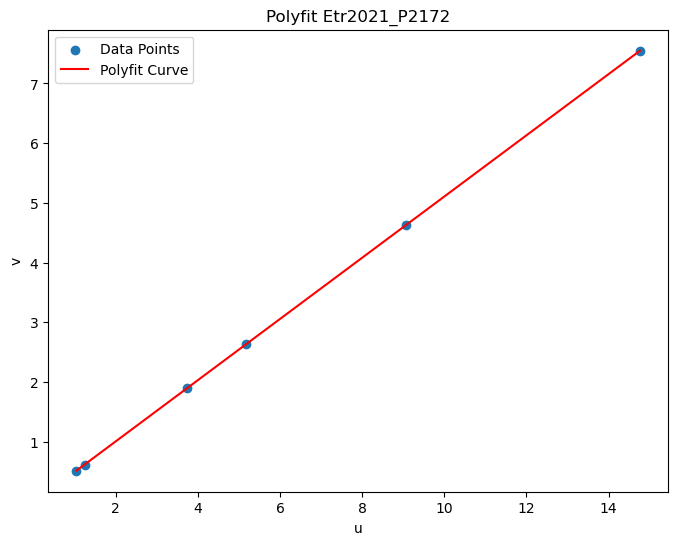

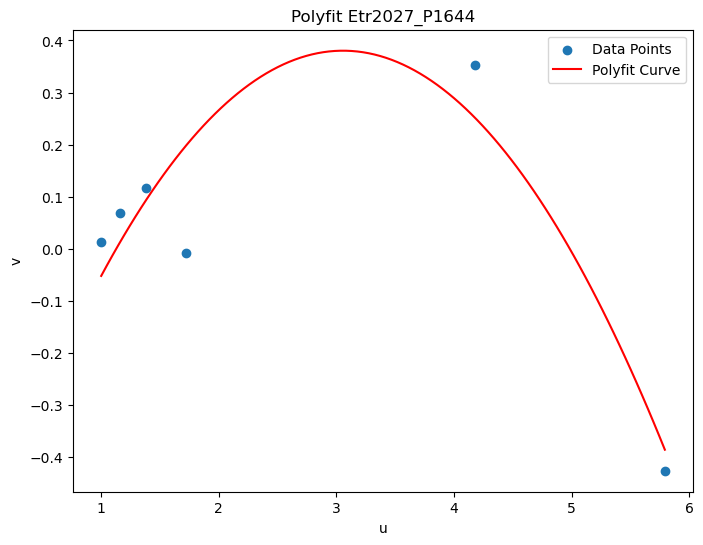

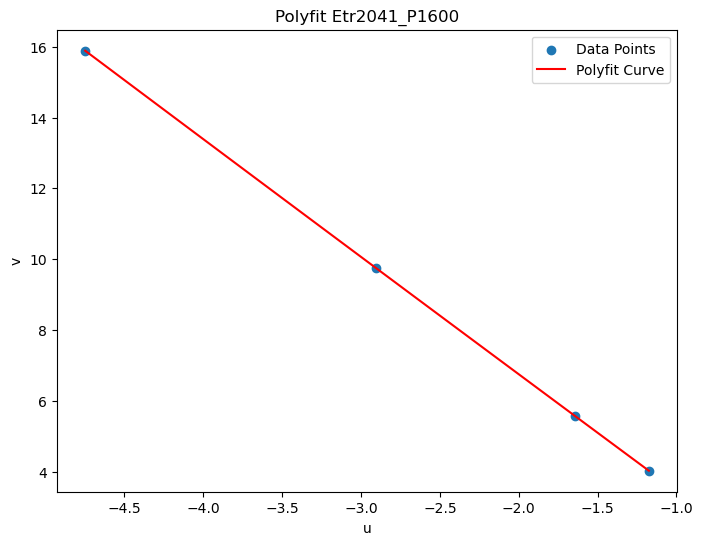

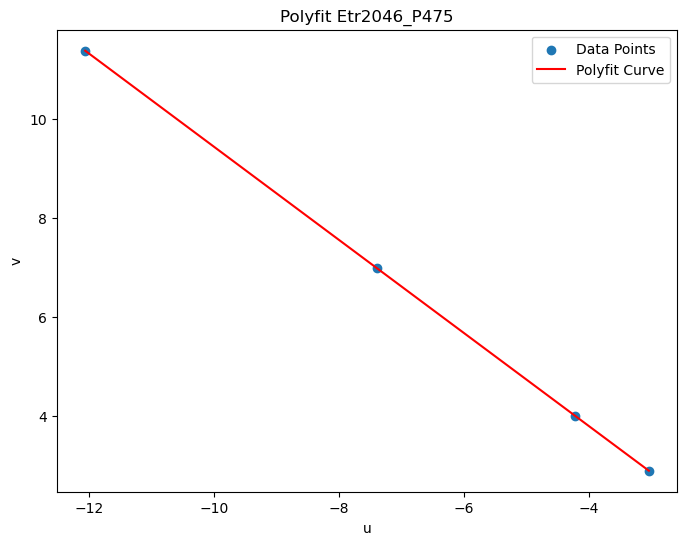

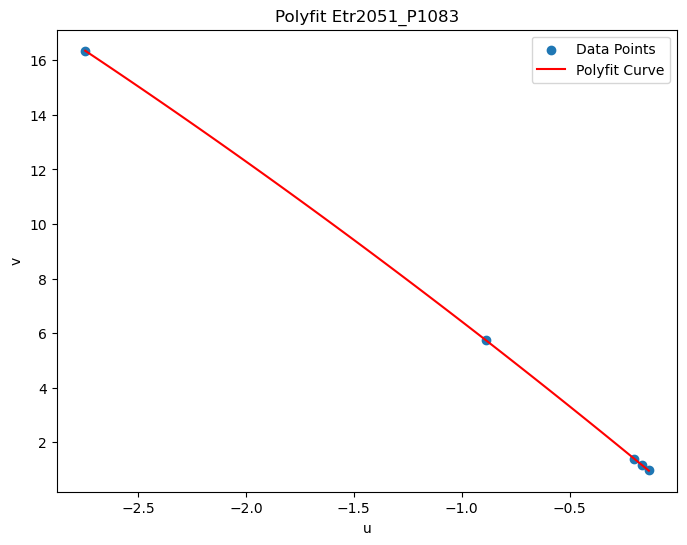

...

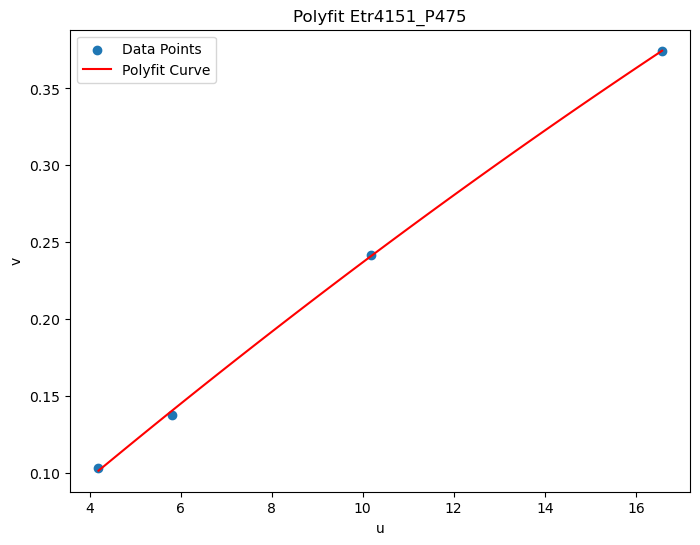

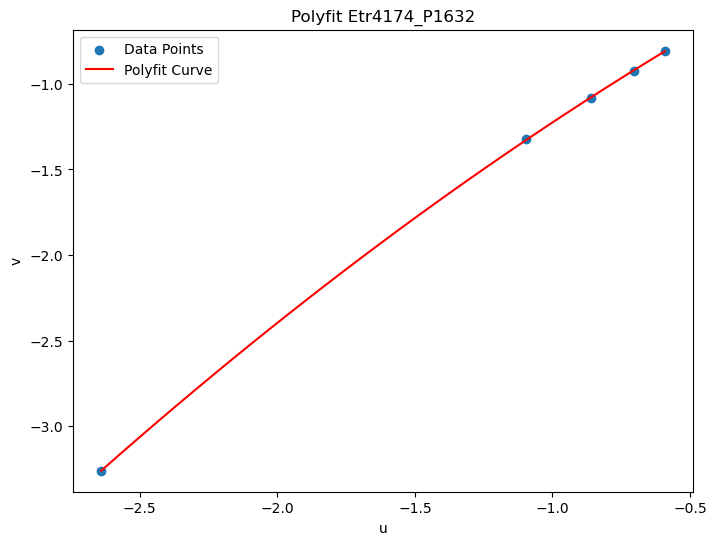

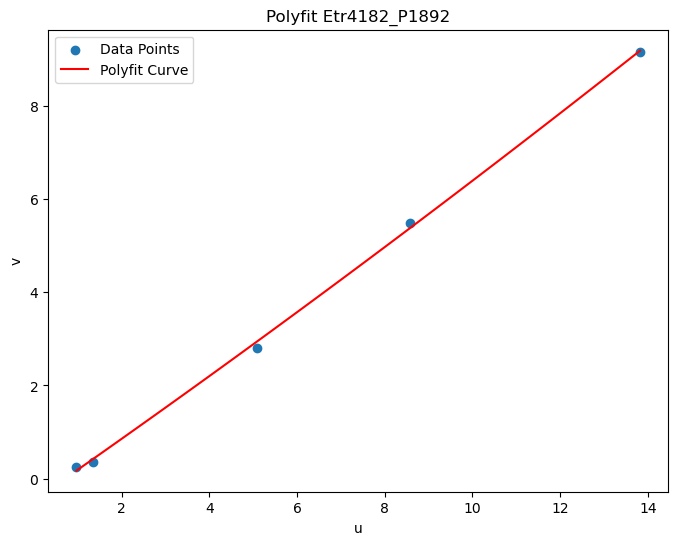

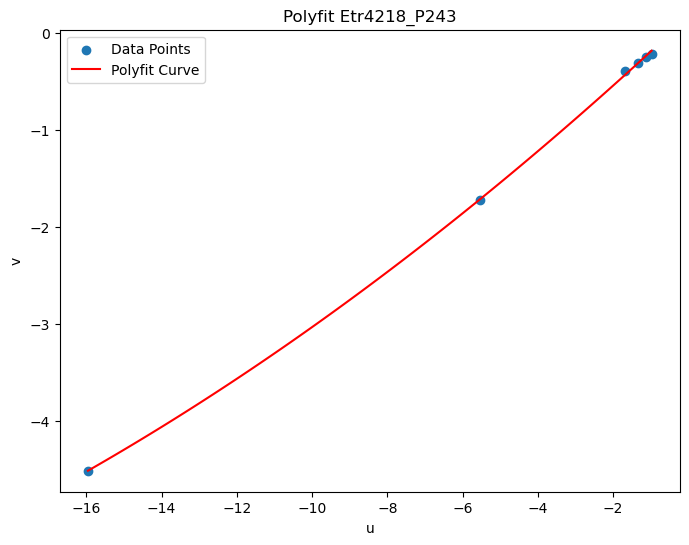

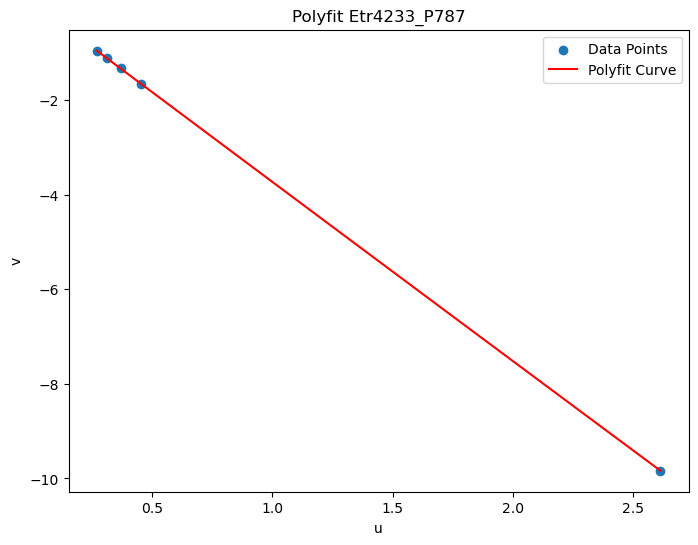

In [25]:
import numpy as np
import pandas as pd
import torch
import matplotlib.pyplot as plt

def conformal_mapping(file):
    # 在这里实现你的拟合逻辑，包括计算 a、b、R、e、pT 等参数
    """
    x, y, z: np.array([])
    return: 
    """
    
    # ref. 10.1016/0168-9002(88)90722-X
    # choose the dataset with different particle_id
    df = pd.read_csv(file)

# 分组数据并进行拟合
    grouped = df.groupby(['event_file', 'particle_id'])
    for group_key, group_data in grouped:
        # 获取分组的 x、y、z、r 数据
        x = group_data['x'].to_numpy()
        y = group_data['y'].to_numpy()
        z = group_data['z'].to_numpy()
        if len(x) < 4 or len(y) < 4: # Choose at least 4hits.
            continue
        event_id = group_data['event_id'].unique()
        event_file = group_data['event_file'].unique()
        particle_id = group_data['particle_id'].unique()

        r = x**2 + y**2
        u = x / r
        v = y / r
        # assuming the imapact parameter is small
        # the v = 1/(2b) - u x a/b - u^2 x epsilon x (R/b)^3
        pp, vv = np.polyfit(u, v, 2, cov=True)
        b = 0.5/pp[2]
        a = -pp[1]*b
        R = np.sqrt(a**2 + b**2)
        e = -pp[0] / (R/b)**3 # approximately equals to d0
        dev = 2*e*R / b**2

        magnetic_field = 2.0
        pT = 0.3*magnetic_field*R # in MeV
        # print(a, b, R, e, pT)

        p_rz = np.polyfit(np.sqrt(r), z, 2)
        y_p_rz = np.polyval(p_rz, np.sqrt(r))
        residuals = z - y_p_rz
        chi_square = np.sum((residuals / y_p_rz)**2)

        y_p_rz = np.polyval(p_rz, np.sqrt(r))
    
        pp_rz = np.poly1d(p_rz)
        z0 = pp_rz(abs(e))

        r3 = np.sqrt(r + z**2)
        p_zr = np.polyfit(r3, z, 2)
    
        cos_val = p_zr[0]*z0 + p_zr[1]
        theta = np.arccos(cos_val)
        eta = -np.log(np.tan(theta/2.))
        phi = np.arctan2(b, a)
  
        u_fit = np.linspace(u.min(), u.max(), 100)  # 生成用于绘制拟合曲线的数据点
        v_fit = np.polyval(pp, u_fit)  # 计算拟合曲线的值

        plt.figure(figsize=(8, 6))
        plt.scatter(u, v, label='Data Points')
        plt.plot(u_fit, v_fit, label='Polyfit Curve', color='red')
        plt.xlabel('u')
        plt.ylabel('v')
        plt.title(f'Polyfit Etr{int(event_file)}_P{int(particle_id)}')
        plt.legend()
        
        output_folder = './plot/fit_event_file'
        os.makedirs(output_folder, exist_ok=True)

        # Save the plot to a file
        plot_filename = os.path.join(output_folder, f'Etr{int(event_file)}_P{int(particle_id)}.png')
        plt.savefig(plot_filename)
        plt.show()
        plt.close()  # Close the plot to release resources
  
   
    return a, b, R, e, pT

# 读取 CSV 文件并提取所需的列
file = f'./output/track_quirk_2000.csv'
a, b, R, e, pT = conformal_mapping(file)